In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import importlib
import re

from scipy import stats
import harmonypy as hm

In [43]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white', dpi_save=900)
sc._settings.ScanpyConfig(max_memory=50, n_jobs=50)

scanpy==1.9.3 anndata==0.10.8 umap==0.5.3 numpy==1.23.5 scipy==1.11.4 pandas==2.2.1 scikit-learn==1.5.1 statsmodels==0.14.2 python-igraph==0.11.6 louvain==0.8.0 pynndescent==0.5.12


In [44]:
sns.set_theme(style="ticks")

---

In [4]:
!pwd

/data/tcl/Project/ADFCA/script2/GitHub_Neuron_20250130/2023_Neuron_Tau_asyn


In [5]:
os.chdir("../../..")

In [6]:
!pwd

/data/tcl/Project/ADFCA


# Load all files

In [7]:
# QC, concat
Neuron2023Folder='Analysis/Figure_2023NeuronTau'
os.makedirs(Neuron2023Folder, exist_ok=True)
Neuron2023PicFolder=f'{Neuron2023Folder}/pic'
os.makedirs(Neuron2023PicFolder, exist_ok=True)

In [8]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)

In [9]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure2PicFolder=f'{figure2Folder}/pic'
os.makedirs(figure2PicFolder, exist_ok=True)

In [10]:
cellnFolder=f'{figure2Folder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figure2Folder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [11]:
figure3Folder=f'{figureDataFolder}/Figure3'
os.makedirs(figure3Folder, exist_ok=True)
figure3PicFolder=f'{figure3Folder}/pic'
os.makedirs(figure3PicFolder, exist_ok=True)

In [12]:
figureTauComFolder = f'{figureDataFolder}/Figure_TauCompare'
os.makedirs(figureTauComFolder, exist_ok=True)
figureTauComPicFolder = f'{figureTauComFolder}/pic'
os.makedirs(figureTauComPicFolder, exist_ok=True)

degGenoControlBroadNeuFolder=f'{figureTauComFolder}/DEG_genotype_toControl_broadNeu'
os.makedirs(degGenoControlBroadNeuFolder, exist_ok=True)

degGenoControlBroadNeuWBodyFolder=f'{figureTauComFolder}/DEG_genotype_toControl_broadNeu_wBody'
os.makedirs(degGenoControlBroadNeuWBodyFolder, exist_ok=True)

In [13]:
degFolder=f'{Neuron2023Folder}/degFolder'
os.makedirs(degFolder, exist_ok=True)

In [14]:
celltypeN700_L = pd.read_csv(f'{figure2Folder}/cellN/celltype_cellN_n700.csv').annotation.to_list()

# Load ADFCA files

In [15]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v1.0/adata_adfca_head_v1.0.h5ad')
# adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v1.0/adata_adfca_body_v1.0.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


# Load count matrix

In [9]:
adata_5_25 = sc.read_mtx(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_5_25d_dataset_soupX_corrected.mtx')
adata_5_25

AnnData object with n_obs × n_vars = 143013 × 17616

In [12]:
adata_5_25.obs = pd.read_csv(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_5_25d_meta_data.tsv', sep='\t', index_col=0)
adata_5_25.obs 

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.1062,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,-4.703946
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.9520,0.040526,N-0-undef,Neuron,undefined,8.366494,2.524369
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.9756,0.000645,N-6-GABA,Neuron,GABA,7.840903,8.637663
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.2631,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,-4.317415
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.0000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,3.945668
...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGAGAAAG-1-P301L-2020-12-02-25d,P301L,2020-12-02,25d,1054,1970.4976,0.053453,TmY8,Neuron,Acetylcholine,23.856583,-1.292472
TTTGTTGCAGCGTACC-1-P301L-2020-12-02-25d,P301L,2020-12-02,25d,941,1702.2488,0.005569,Mi4,Neuron,GABA,6.896786,16.192352
TTTGTTGCATCTCGTC-1-P301L-2020-12-02-25d,P301L,2020-12-02,25d,787,1353.8550,0.013642,Dm2,Neuron,Acetylcholine,16.501692,12.060422
TTTGTTGGTTAGAGTA-1-P301L-2020-12-02-25d,P301L,2020-12-02,25d,687,1124.6014,0.012311,TmY8,Neuron,Acetylcholine,23.662582,-2.671996


In [36]:
var = pd.read_csv(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_5_25d_dataset_genes.tsv.gz', sep='\t', index_col=0, header=None)
var.index.name = None
var.index = [str(var) for var in adata_5_25.var_names]

var.columns = ['FlyBaseID']
var['geneName'] = var.index.to_list()

adata_5_25.var = var
adata_5_25.var

,FlyBaseID,geneName
7SLRNA:CR32864,FBgn0000003,7SLRNA:CR32864
a,FBgn0000008,a
abd-A,FBgn0000014,abd-A
Abd-B,FBgn0000015,Abd-B
Abl,FBgn0000017,Abl
...,...,...
Datp,FBgn0287788,Datp
QF2w,QF2w,QF2w
a-syn[A53T],asynA53T,a-syn[A53T]
smGdP::V5,smGdPV5,smGdP::V5


In [22]:
adata_5_25.var = var
adata_5_25.var

,FlyBaseID,geneName
7SLRNA:CR32864,FBgn0000003,7SLRNA:CR32864
a,FBgn0000008,a
abd-A,FBgn0000014,abd-A
Abd-B,FBgn0000015,Abd-B
Abl,FBgn0000017,Abl
...,...,...
Datp,FBgn0287788,Datp
QF2w,QF2w,QF2w
a-syn[A53T],asynA53T,a-syn[A53T]
smGdP::V5,smGdPV5,smGdP::V5


In [13]:
adata_5_25.obs.broad_annotation.value_counts()

broad_annotation
Neuron            139003
Glia                3884
Hemocytes             88
Photoreceptors        38
Name: count, dtype: int64

In [14]:
adata_5_25.obs.age.value_counts()

age
25d    76300
5d     66713
Name: count, dtype: int64

In [16]:
adata_5_25.var

""
0
1
2
3
4
...
17611
17612
17613
17614


In [24]:
adata_5_25.X[:10, :10].todense()

matrix([[0.        , 0.        , 0.        , 0.        , 0.93956876,
         0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.87073827, 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.86557096,
         0.        , 0.        , 0.754569  , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.8845352 ,
         0.        , 0.        , 1.8354126 , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 1.8018452 ,
         0.        , 0.        , 2.638223  , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 1.8677491 ,
         0.        , 0.        , 1.8114852 , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 1.9131416 ,
         0.        , 0.        , 2.8650835 , 0.        , 0.        ],
        [0.        , 0.    

In [55]:
adata_5_25.obsm['X_umap'] = adata_5_25.obs.loc[:,['UMAP_x', 'UMAP_y']].to_numpy()

In [57]:
adata_5_25.obs.genotype.value_counts()

genotype
mini     39987
P301L    35366
smGdP    35045
A53T     32615
Name: count, dtype: int64

In [23]:
adata_45 = sc.read_mtx(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_45d_dataset_soupX_corrected.mtx')
adata_45

AnnData object with n_obs × n_vars = 121108 × 17615

In [25]:
adata_45.X[:10, :10].todense()

matrix([[ 0.        ,  6.9536686 ,  7.9010277 ,  0.        ,  0.        ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  4.9227333 , 17.839993  ,  0.9727166 ,  0.        ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  1.9683608 ,  2.9360044 ,  0.        ,  0.        ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  1.9731357 ,  4.9483323 ,  0.        ,  0.        ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  1.9693472 ,  0.93799967,  0.        ,  0.        ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        , 15.739552  , 44.46065   ,  0.        ,  1.829674  ,
          0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.9744843 ,  6.9455957 ,  0.        ,  0.        ,
          0.        ,  0.       

In [26]:
adata_45.obs = pd.read_csv(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_45d_meta_data.tsv', sep='\t', index_col=0)
adata_45.obs 

,genotype,age,n_genes,n_counts,mt_frac,cell_types_integrated_label_transfer,UMAP_x,UMAP_y
AAACCCAAGTAAGACT-1-20220412_P301L_45d,P301L,45d,1409,2782.83520,0.008032,N-5-ACh,3.358510,12.336417
AAACCCAAGTTGTCAC-1-20220412_P301L_45d,P301L,45d,1765,4452.88600,0.005311,N-3-ACh,2.172630,11.074736
AAACCCACATTATGCG-1-20220412_P301L_45d,P301L,45d,881,1694.74910,0.001808,N-81-ACh,11.732514,11.728661
AAACCCATCCTGTAGA-1-20220412_P301L_45d,P301L,45d,784,1336.34100,0.006577,TmY14,7.826670,22.268288
AAACCCATCGTGCATA-1-20220412_P301L_45d,P301L,45d,819,1654.51950,0.000000,Tm1,7.420219,-1.842630
...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,45d,517,715.58417,0.000562,100,7.168665,12.863668
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,45d,747,1563.25460,0.122535,Tm2,15.107158,-2.239052
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,45d,1256,2514.68000,0.005784,N-0-undef,4.652971,14.690056
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,45d,826,1267.95040,0.006793,65,6.348648,6.168818


In [35]:
var = pd.read_csv(f'/data/tcl/dataset/fly_scRNA/2023_Neuron_tau_asyn/counts/GSE223626_45d_dataset_genes.tsv.gz', sep='\t', index_col=0, header=None)
var.index.name = None
var.index = [str(var) for var in adata_45.var_names]

var.columns = ['FlyBaseID']
var['geneName'] = var.index.to_list()

adata_45.var = var
adata_45.var

,FlyBaseID,geneName
128up,FBgn0010339,128up
14-3-3epsilon,FBgn0020238,14-3-3epsilon
14-3-3zeta,FBgn0004907,14-3-3zeta
140up,FBgn0010340,140up
18SrRNA-Psi:CR41602,FBgn0085813,18SrRNA-Psi:CR41602
...,...,...
zormin,FBgn0052311,zormin
zpg,FBgn0024177,zpg
zuc,FBgn0261266,zuc
zyd,FBgn0265767,zyd


In [45]:
adata_45.obsm['X_umap'] = adata_45.obs.loc[:,['UMAP_x', 'UMAP_y']].to_numpy()

In [34]:
[var for var in adata_45.var_names if var.startswith('mt:')]

['mt:ATPase6',
 'mt:ATPase8',
 'mt:CoI',
 'mt:CoII',
 'mt:CoIII',
 'mt:Cyt-b',
 'mt:ND1',
 'mt:ND2',
 'mt:ND3',
 'mt:ND4',
 'mt:ND4L',
 'mt:ND5',
 'mt:ND6',
 'mt:lrRNA',
 'mt:srRNA',
 'mt:tRNA:Ala-TGC',
 'mt:tRNA:Arg-TCG',
 'mt:tRNA:Asn-GTT',
 'mt:tRNA:Asp-GTC',
 'mt:tRNA:Cys-GCA',
 'mt:tRNA:Gln-TTG',
 'mt:tRNA:Glu-TTC',
 'mt:tRNA:Gly-TCC',
 'mt:tRNA:His-GTG',
 'mt:tRNA:Ile-GAT',
 'mt:tRNA:Leu-TAA',
 'mt:tRNA:Leu-TAG',
 'mt:tRNA:Lys-CTT',
 'mt:tRNA:Met-CAT',
 'mt:tRNA:Phe-GAA',
 'mt:tRNA:Pro-TGG',
 'mt:tRNA:Ser-GCT',
 'mt:tRNA:Ser-TGA',
 'mt:tRNA:Thr-TGT',
 'mt:tRNA:Trp-TCA',
 'mt:tRNA:Tyr-GTA',
 'mt:tRNA:Val-TAC']

In [37]:
adata_Neuron2023 = sc.concat([adata_5_25, adata_45], join='outer')
adata_Neuron2023

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 264121 × 17617
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer'

In [38]:
adata_Neuron2023.var

""
128up
14-3-3epsilon
14-3-3zeta
140up
18SrRNA-Psi:CR41602
...
zormin
zpg
zuc
zyd


In [39]:
adata_Neuron2023.obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.10620,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,-4.703946,NaN
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.95200,0.040526,N-0-undef,Neuron,undefined,8.366494,2.524369,NaN
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.97560,0.000645,N-6-GABA,Neuron,GABA,7.840903,8.637663,NaN
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.26310,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,-4.317415,NaN
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.00000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,3.945668,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,NaN,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,12.863668,100
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,NaN,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,-2.239052,Tm2
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,NaN,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,14.690056,N-0-undef
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,NaN,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,6.168818,65


In [59]:
adata_Neuron2023.write(f'{Neuron2023Folder}/1.concat.h5ad')

# Regular pipeline

## log normalization to PCA & NN

In [64]:
adata_Neuron2023 = sc.read((f'{Neuron2023Folder}/1.concat.h5ad'))
adata_Neuron2023

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 264121 × 17617
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer'

In [66]:
adata_Neuron2023.var["mt"] = adata_Neuron2023.var_names.str.startswith("mt:")
sc.pp.calculate_qc_metrics(
    adata_Neuron2023, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

In [67]:
# Normalized
sc.pp.normalize_total(adata_Neuron2023, target_sum=1e4)
sc.pp.log1p(adata_Neuron2023)

normalizing counts per cell
    finished (0:00:02)


extracting highly variable genes
    finished (0:00:20)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


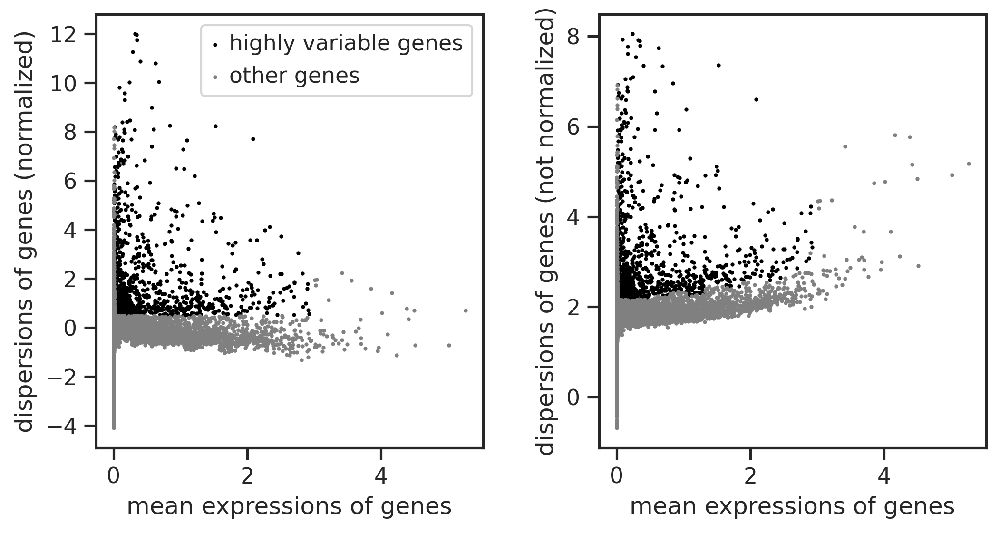

highly_variable
False    16469
True      1148
Name: count, dtype: int64

In [68]:
# HVG
sc.pp.highly_variable_genes(adata_Neuron2023, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_Neuron2023)
adata_Neuron2023.var['highly_variable'].value_counts()

In [70]:
adata_Neuron2023.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm
128up,False,20959,0.084996,92.064622,2.244902e+04,False,0.249813,1.749594,-0.162102
14-3-3epsilon,False,237417,5.091891,10.110518,1.345023e+06,False,2.813553,1.958527,-1.314715
14-3-3zeta,False,252959,11.111524,4.226093,2.934997e+06,False,3.495543,2.872050,-0.675790
140up,False,13096,0.053481,95.041667,1.412531e+04,False,0.153385,1.720581,-0.208967
18SrRNA-Psi:CR41602,False,49787,0.350053,81.149927,9.245643e+04,True,0.889298,2.785759,1.243704
...,...,...,...,...,...,...,...,...,...
zormin,False,2140,0.009843,99.189765,2.599808e+03,True,0.041265,2.282306,0.698417
zpg,False,11,0.000049,99.995835,1.298922e+01,False,0.000162,2.048657,0.320991
zuc,False,25,0.000105,99.990535,2.771125e+01,False,0.000481,2.207049,0.576851
zyd,False,7262,0.065357,97.250503,1.726226e+04,True,0.206451,2.802239,1.538293


In [71]:
hvg_L = adata_Neuron2023.var[ 
        (adata_Neuron2023.var.means > 0.0125) & 
        (adata_Neuron2023.var.means <= 3 ) ].dispersions_norm.sort_values(ascending=False)[:2000].index.to_list()
print('hvg #: ', len(hvg_L))
adata_Neuron2023.var['highly_variable']= [True if var in hvg_L else False for var in adata_Neuron2023.var_names ]
adata_Neuron2023.var['highly_variable'].value_counts()

hvg #:  2000


highly_variable
False    15617
True      2000
Name: count, dtype: int64

In [72]:
adata_Neuron2023.raw = adata_Neuron2023
adata_Neuron2023 = adata_Neuron2023[:, adata_Neuron2023.var.highly_variable]

sc.pp.regress_out(adata_Neuron2023, ['total_counts'])
sc.pp.scale(adata_Neuron2023, max_value=10)

regressing out ['total_counts']
    sparse input is densified and may lead to high memory use


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


    finished (0:03:14)


In [74]:
adata_Neuron2023

AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:01:07)


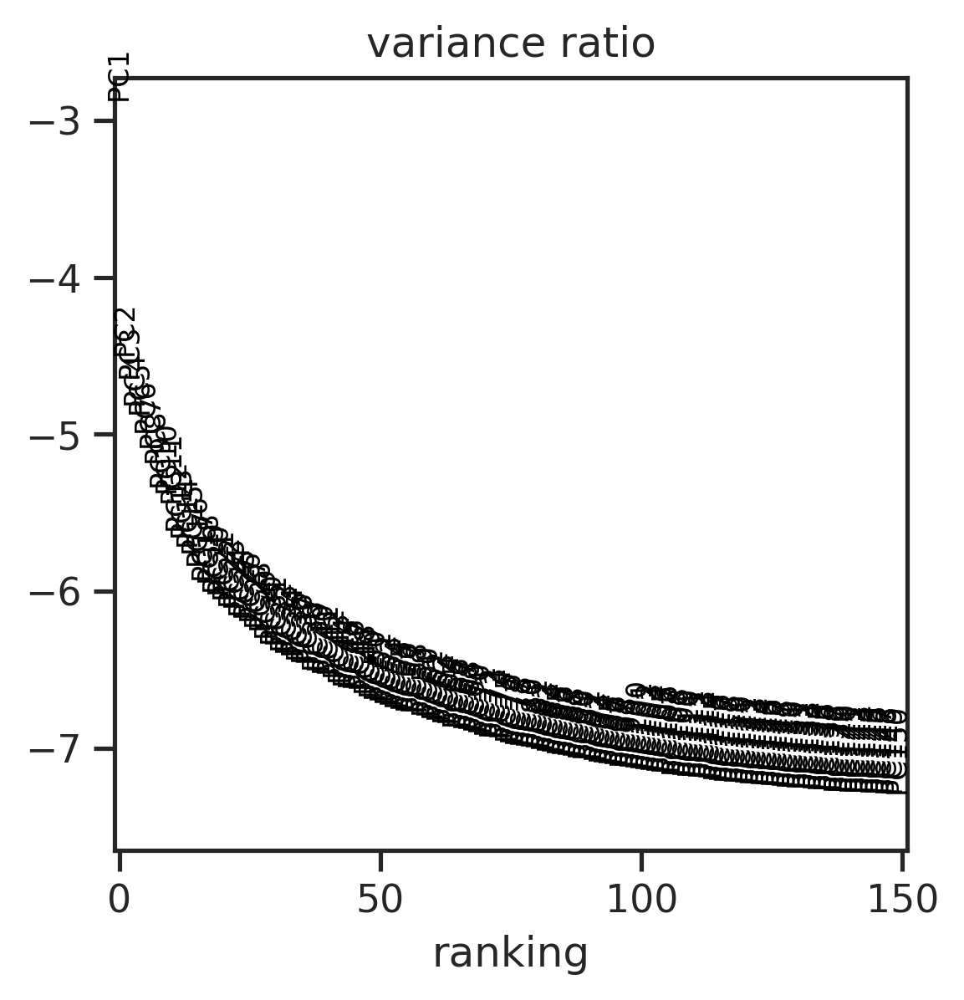

In [75]:
# PCA
sc.tl.pca(adata_Neuron2023, svd_solver='arpack', n_comps=150)
sc.pl.pca_variance_ratio(adata_Neuron2023, log=True, n_pcs=150)

In [76]:
# nn
sc.pp.neighbors(adata_Neuron2023, n_neighbors=10, n_pcs= 150)

computing neighbors
    using 'X_pca' with n_pcs = 150
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:40)


In [79]:
adata_Neuron2023.write(f'{Neuron2023Folder}/2.logNor_toPCA_nn.h5ad')

## Embedding the neighborhood graph

In [80]:
adata_Neuron2023 = sc.read(f'{Neuron2023Folder}/2.logNor_toPCA_nn.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [81]:
# process always die
sc.tl.tsne(adata_Neuron2023, n_jobs=60)

computing tSNE
    using 'X_pca' with n_pcs = 150
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:53:48)


In [82]:
sc.tl.umap(adata_Neuron2023)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:51)


In [83]:
sc.tl.leiden(adata_Neuron2023)

running Leiden clustering
    finished: found 171 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:47)


In [106]:
### remove duplicatedindexxes
index_L = []
for idx in adata_Neuron2023.obs_names.to_list(): #[:3]:
    # print(idx)

    if idx not in index_L: index_L.append(idx)
    else: 
#         barcode, geno, age = idx.split('_')
#         barcode_L = barcode.split('-')
#         barcode_L.insert(2, '1')
#         newBC = '_'.join(['-'.join(barcode_L), geno, age])
    
#         barcode_L[2] = str(int(barcode_L[2])+1)
#         newBC = '_'.join(['-'.join(barcode_L), geno, age])
        
        repN=2
        newBC = idx+f'_rep{repN}'
        print(newBC)
        while newBC in index_L:
            repN+=1
            newBC = idx+f'_rep{repN}'
        
        index_L.append(newBC)
        
print(len(index_L))

AGAGCAGGTCCCGCAA-1-20220412_P301L_45d_rep2
CACGAATAGCTGTACT-1-20220412_P301L_45d_rep2
CATCAAGGTCCGAAAG-1-20220412_P301L_45d_rep2
CATGCGGAGCGAATGC-1-20220412_P301L_45d_rep2
GGTGTTACATCTAGAC-1-20220412_P301L_45d_rep2
GTGCTGGCAAGGCCTC-1-20220412_P301L_45d_rep2
GTGGAAGAGCCATTTG-1-20220412_P301L_45d_rep2
TCAGCAAAGCGTTGTT-1-20220412_P301L_45d_rep2
TTTACGTAGGCTTCCG-1-20220412_P301L_45d_rep2
AAAGGTAAGTTGCTCA-1-20220412_mini_45d_rep2
ATCACTTTCCTTCTTC-1-20220412_mini_45d_rep2
ATCGTGAGTAACATAG-1-20220412_mini_45d_rep2
CAGCAATGTCATGCAT-1-20220412_mini_45d_rep2
CCTCAGTGTTGTTGAC-1-20220412_mini_45d_rep2
CCTGCATTCTCCTGTG-1-20220412_mini_45d_rep2
CGCATAATCAGCTCTC-1-20220412_mini_45d_rep2
CTCATGCCATAGCTGT-1-20220412_mini_45d_rep2
CTTCGGTTCCATGAGT-1-20220412_mini_45d_rep2
GTCTGTCTCGTAACTG-1-20220412_mini_45d_rep2
TAATCTCTCGCCAGTG-1-20220412_mini_45d_rep2
TAGGGTTGTTATCTGG-1-20220412_mini_45d_rep2
TATATCCGTCGCATTA-1-20220412_mini_45d_rep2
TCTCACGGTCAGACTT-1-20220412_mini_45d_rep2
TGCATCCTCTTGGTGA-1-202204

In [107]:
adata_Neuron2023

AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap', 'age_colors', 'genotype_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [108]:
adata_Neuron2023.obs.index = index_L

In [109]:
adata_Neuron2023.obs[adata_Neuron2023.obs.index.duplicated()]

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden


In [115]:
adata_Neuron2023.obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.10620,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,-4.703946,NaN,1018,1781.106323,70.859940,3.978423,57
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.95200,0.040526,N-0-undef,Neuron,undefined,8.366494,2.524369,NaN,841,1575.952026,63.867630,4.052638,5
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.97560,0.000645,N-6-GABA,Neuron,GABA,7.840903,8.637663,NaN,1667,4609.975586,2.975180,0.064538,43
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.26310,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,-4.317415,NaN,1072,1930.262939,155.206284,8.040681,57
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.00000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,3.945668,NaN,2299,6760.000000,155.274261,2.296957,56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,NaN,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,12.863668,100,517,715.584106,0.401946,0.056170,125
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,NaN,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,-2.239052,Tm2,747,1563.254639,191.552841,12.253464,40
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,NaN,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,14.690056,N-0-undef,1256,2514.679932,14.545169,0.578410,82
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,NaN,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,6.168818,65,826,1267.950317,8.613487,0.679324,26


In [110]:
adata_Neuron2023.write(f'{Neuron2023Folder}/3.neighbors.h5ad')

In [111]:
adata_Neuron2023.raw.to_adata().write(f'{Neuron2023Folder}/3.neighbors_raw.h5ad')

### Plot

In [86]:
adata_Neuron2023 = sc.read(f'{Neuron2023Folder}/3.neighbors.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [88]:
adata_Neuron2023

AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap', 'age_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [89]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata_Neuron2023,color=["age", 'genotype'], frameon=False, ncols=3, show=False,
               save = f'_adata_Neuron2023_age_genotype.pdf')
    sc.pl.tsne(adata_Neuron2023,color=["age", 'genotype'], frameon=False, ncols=3, show=False,
               save = f'_adata_Neuron2023_age_genotype.pdf')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

In [90]:
with rc_context({'figure.figsize': (6, 6)}):
    for genotype in adata_Neuron2023.obs.genotype.cat.categories:
        sc.pl.umap(adata_Neuron2023,color=['genotype'], groups=genotype, frameon=False, na_in_legend=False, size=2, show=False,
                   save = f'_adata_Neuron2023_genotype_{genotype}.pdf')
        sc.pl.tsne(adata_Neuron2023,color=['genotype'], groups=genotype, frameon=False, na_in_legend=False, size=2, show=False,
                   save = f'_adata_Neuron2023_genotype_{genotype}.pdf')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


In [93]:
len(adata_Neuron2023.obs.genotype.cat.categories)

4

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

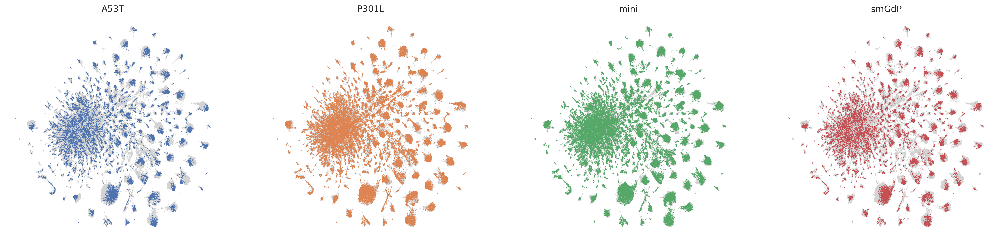

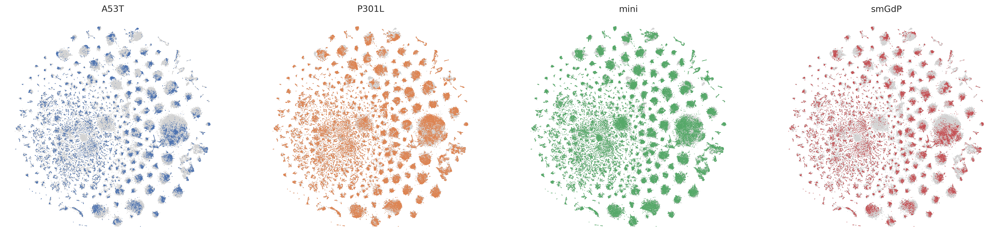

In [94]:
# with rc_context({'figure.figsize': (18, 6)}):
figU, axsU = plt.subplots(1, 4, figsize=(24, 5.5))
for n, genotype in enumerate(adata_Neuron2023.obs.genotype.cat.categories):
    sc.pl.umap(adata_Neuron2023,color=['genotype'], groups=genotype, frameon=False, legend_loc=False,
               na_in_legend=False, size=2, show=False, ax= axsU[n], title=genotype)
plt.savefig(f'{Neuron2023Folder}/umap_adata_Neuron2023_genotype_each.pdf', bbox_inches='tight')

fig, axs = plt.subplots(1, 4, figsize=(24, 5.5))
for n, genotype in enumerate(adata_Neuron2023.obs.genotype.cat.categories):
    sc.pl.tsne(adata_Neuron2023,color=['genotype'], groups=genotype, frameon=False, legend_loc=False,
               na_in_legend=False, size=2, show=False, ax= axs[n], title=genotype)
plt.savefig(f'{Neuron2023Folder}/tsne_adata_Neuron2023_genotype_each.pdf', bbox_inches='tight')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map)

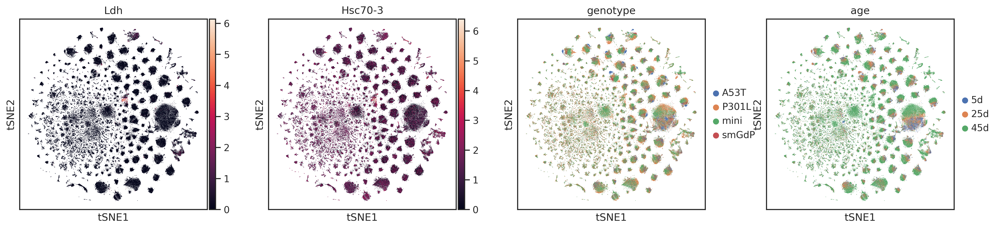

In [97]:
sc.pl.tsne(adata_Neuron2023, color=['Ldh', 'Hsc70-3', 'genotype', 'age'])

In [95]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{Neuron2023PicFolder}/{x}')

In [98]:
adata_Neuron2023.obs[adata_Neuron2023.obs.index.duplicated()]

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AGAGCAGGTCCCGCAA-1-20220412_P301L_45d,P301L,NaN,45d,785,1252.7677,0.000117,NaN,NaN,NaN,19.056130,3.387919,TmY5a,785,1252.767700,0.146396,0.011686,22
CACGAATAGCTGTACT-1-20220412_P301L_45d,P301L,NaN,45d,1362,3005.7537,0.033553,NaN,NaN,NaN,3.932211,4.549303,4,1362,3005.753418,100.852448,3.355314,118
CATCAAGGTCCGAAAG-1-20220412_P301L_45d,P301L,NaN,45d,926,1638.9982,0.000723,NaN,NaN,NaN,-4.671756,6.545057,A/B-KC,926,1638.998169,1.184368,0.072262,4
CATGCGGAGCGAATGC-1-20220412_P301L_45d,P301L,NaN,45d,941,1853.2404,0.037538,NaN,NaN,NaN,4.726876,14.850537,N-0-undef,941,1853.240356,69.567375,3.753824,1
GGTGTTACATCTAGAC-1-20220412_P301L_45d,P301L,NaN,45d,1880,4492.3677,0.000000,NaN,NaN,NaN,2.453362,13.101977,N-0-undef,1880,4492.367676,0.000000,0.000000,49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGGTTAAGCGACTAG-1-20220502_mini_45d,mini,NaN,45d,1477,3033.3801,0.001449,NaN,NaN,NaN,3.269961,9.946661,N-3-ACh,1477,3033.380371,4.394538,0.144873,1
TAGCACATCGGCTGTG-1-20220502_mini_45d,mini,NaN,45d,612,893.3679,0.001528,NaN,NaN,NaN,11.670230,20.024040,N-33-ACh,612,893.367920,1.365451,0.152843,36
TATCGCCGTATGGAAT-1-20220502_mini_45d,mini,NaN,45d,1114,2209.7922,0.000000,NaN,NaN,NaN,4.889430,0.109421,Mi1,1114,2209.792236,0.000000,0.000000,23
TATCGCCGTTCGTACA-1-20220502_mini_45d,mini,NaN,45d,451,766.7186,0.015969,NaN,NaN,NaN,15.003252,5.986021,Plasmatocytes,451,766.718628,12.243356,1.596851,151


In [99]:
adata_Neuron2023.obs[adata_Neuron2023.obs.index == 'AGAGCAGGTCCCGCAA-1-20220412_P301L_45d']

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden
AGAGCAGGTCCCGCAA-1-20220412_P301L_45d,P301L,NaN,45d,1056,1952.8899,0.029100,NaN,NaN,NaN,11.589029,13.838038,N-102-Glut,1056,1952.889893,56.829411,2.910016,87
AGAGCAGGTCCCGCAA-1-20220412_P301L_45d,P301L,NaN,45d,785,1252.7677,0.000117,NaN,NaN,NaN,19.056130,3.387919,TmY5a,785,1252.767700,0.146396,0.011686,22


## annotation transfer

In [121]:
from sklearn import svm
from sklearn import metrics
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

In [ ]:
adata_Neuron2023 = sc.read(f'{Neuron2023Folder}/3.neighbors.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [ ]:
adata_Neuron2023

AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [127]:
adata_Neuron2023.obs['true']=\
    adata_Neuron2023.obs.cell_types_integrated[
    adata_Neuron2023.obs.age != '45d']

In [128]:
adata_ref = adata_Neuron2023[adata_Neuron2023.obs.age != '45d']
adata_query=adata_Neuron2023[adata_Neuron2023.obs.age == '45d']

In [129]:
X_test = adata_query.obsm['X_pca']
X_train = adata_ref.obsm['X_pca']
y_train = list(adata_ref.obs.true)
clf = LogisticRegression(random_state=1, max_iter=6000)
clf.fit(X_train, y_train)
preds_ct = clf.predict(X_test)

In [130]:
adata_query.obs['true'] = pd.Categorical(preds_ct)
new_annot = dict(zip(adata_query.obs_names, adata_query.obs.true))
adata_query.obs['true'] = pd.Categorical(
    [new_annot[c] if c in new_annot else adata_query.obs.true[i] 
     for i, c in enumerate(adata_query.obs_names)])
mapping_D = dict(zip(adata_query.obs_names, adata_query.obs['true']))

<ipython-input-130-c0a02a8d897d>:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_query.obs['true'] = pd.Categorical(preds_ct)


In [131]:
adata_Neuron2023.obs['linearR_annotation']=\
    pd.Categorical([ mapping_D[obs] if obs in mapping_D.keys() else adata_Neuron2023.obs.loc[obs, 'cell_types_integrated'] for obs in adata_Neuron2023.obs_names])

In [132]:
len(adata_Neuron2023.obs.linearR_annotation.cat.categories)

208

In [133]:
adata_Neuron2023.obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,true,linearR_annotation
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.10620,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,-4.703946,NaN,1018,1781.106323,70.859940,3.978423,57,N-53-Glut,N-53-Glut
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.95200,0.040526,N-0-undef,Neuron,undefined,8.366494,2.524369,NaN,841,1575.952026,63.867630,4.052638,5,N-0-undef,N-0-undef
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.97560,0.000645,N-6-GABA,Neuron,GABA,7.840903,8.637663,NaN,1667,4609.975586,2.975180,0.064538,43,N-6-GABA,N-6-GABA
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.26310,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,-4.317415,NaN,1072,1930.262939,155.206284,8.040681,57,N-53-Glut,N-53-Glut
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.00000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,3.945668,NaN,2299,6760.000000,155.274261,2.296957,56,N-3-ACh,N-3-ACh
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,NaN,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,12.863668,100,517,715.584106,0.401946,0.056170,125,NaN,N-137-Glut
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,NaN,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,-2.239052,Tm2,747,1563.254639,191.552841,12.253464,40,NaN,Tm2
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,NaN,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,14.690056,N-0-undef,1256,2514.679932,14.545169,0.578410,82,NaN,N-0-undef
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,NaN,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,6.168818,65,826,1267.950317,8.613487,0.679324,26,NaN,N-6-GABA


In [134]:
broadAnnot_D = dict(zip(adata_Neuron2023.obs.cell_types_integrated, adata_Neuron2023.obs.broad_annotation))

In [135]:
adata_Neuron2023.obs['annotation_broad'] = pd.Categorical([broadAnnot_D[annot] for annot in adata_Neuron2023.obs.linearR_annotation])
adata_Neuron2023.obs['annotation_broad'].value_counts()

annotation_broad
Neuron            253413
Glia                9122
Hemocytes            922
Photoreceptors       664
Name: count, dtype: int64

In [137]:
adata_Neuron2023.obs['genotype'].value_counts()

genotype
mini     105488
P301L     90973
smGdP     35045
A53T      32615
Name: count, dtype: int64

In [136]:
adata_Neuron2023.write(f'{Neuron2023Folder}/4.annotTransfer_annotBroad.h5ad')
adata_Neuron2023.raw.to_adata().write(f'{Neuron2023Folder}/4.annotTransfer_annotBroad_raw.h5ad')

# Neurons vulnerable to hTau: compare different studies

## Funciont summarize cellN

In [17]:
def cellN_cellRatio(adata, sampleCol, annotCol):
    """
    Calculate the cell-type numbers and ratios in each sample
    """
    # print(sampleCol, annotCol)

    # cellN
    cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)
    cellN_Df.columns = list(cellN_Df.columns.get_level_values(1))
    cellN_Df.index.name = None
    # cellN_Df = cellN_Df.loc[:, umiCol_L ] # + ['unknown']
    # cellN_Df

    cellN_ratio = pd.DataFrame(index=cellN_Df.index.to_list(), columns= cellN_Df.columns.to_list())
    for dataset_each in cellN_Df.index:
        cellN_ratio.loc[dataset_each]= cellN_Df.loc[dataset_each]/cellN_Df.loc[dataset_each].sum()

    return(cellN_Df, cellN_ratio)

## Load adata files

In [18]:
adata_adfcaHead = sc.read('/data/tcl/Project/ADFCA/adataProcess/v1.0/adata_adfca_head_v1.0.h5ad')
adata_adfcaHead = adata_adfcaHead[ (adata_adfcaHead.obs.age.isin(['20', '30'])) & (~adata_adfcaHead.obs.genotype.isin(['AB42'])) ]

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [19]:
adata_adfcaHead.obs.genoAge.cat.categories

Index(['control_20', 'control_30', 'hTau_20', 'hTau_30'], dtype='object')

In [20]:
adata_Neuron2023 = sc.read(f'{Neuron2023Folder}/4.annotTransfer_annotBroad.h5ad')
adata_Neuron2023

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [21]:
adata_Neuron2023.obs.genotype.cat.categories

Index(['A53T', 'P301L', 'mini', 'smGdP'], dtype='object')

In [22]:
adata_Neuron2023 = adata_Neuron2023[ (adata_Neuron2023.obs.genotype.isin(['mini', 'P301L'])) ]
adata_Neuron2023

View of AnnData object with n_obs × n_vars = 196461 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [23]:
adata_Neuron2023.obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,UMAP_y,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,true,linearR_annotation,annotation_broad
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.10620,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,-4.703946,NaN,1018,1781.106323,70.859940,3.978423,57,N-53-Glut,N-53-Glut,Neuron
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.95200,0.040526,N-0-undef,Neuron,undefined,8.366494,2.524369,NaN,841,1575.952026,63.867630,4.052638,5,N-0-undef,N-0-undef,Neuron
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.97560,0.000645,N-6-GABA,Neuron,GABA,7.840903,8.637663,NaN,1667,4609.975586,2.975180,0.064538,43,N-6-GABA,N-6-GABA,Neuron
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.26310,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,-4.317415,NaN,1072,1930.262939,155.206284,8.040681,57,N-53-Glut,N-53-Glut,Neuron
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.00000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,3.945668,NaN,2299,6760.000000,155.274261,2.296957,56,N-3-ACh,N-3-ACh,Neuron
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,NaN,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,12.863668,100,517,715.584106,0.401946,0.056170,125,NaN,N-137-Glut,Neuron
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,NaN,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,-2.239052,Tm2,747,1563.254639,191.552841,12.253464,40,NaN,Tm2,Neuron
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,NaN,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,14.690056,N-0-undef,1256,2514.679932,14.545169,0.578410,82,NaN,N-0-undef,Neuron
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,NaN,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,6.168818,65,826,1267.950317,8.613487,0.679324,26,NaN,N-6-GABA,Neuron


In [25]:
adata_Neuron2023.obs.date = pd.Categorical([adata_Neuron2023.obs.index[n].split('_')[0].split('-')[-1]  if age == '45d' else adata_Neuron2023.obs.date[n] for n, age in enumerate(adata_Neuron2023.obs.age) ])
adata_Neuron2023.obs.date.value_counts()

<ipython-input-25-3f4341c83dac>:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  adata_Neuron2023.obs.date = pd.Categorical([adata_Neuron2023.obs.index[n].split('_')[0].split('-')[-1]  if age == '45d' else adata_Neuron2023.obs.date[n] for n, age in enumerate(adata_Neuron2023.obs.age) ])
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/pandas/core/generic.py:6326: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self[name] = value


date
20220502      41165
20220421      29528
20220412      25493
20220425      24922
2020-12-02    14276
2020-11-16    13964
2020-06-18    12530
2020-11-23    12336
2020-11-26    12154
2020-09-23    10093
Name: count, dtype: int64

In [26]:
adata_Neuron2023.obs['genoDate'] = pd.Categorical( adata_Neuron2023.obs.genotype.astype(str) + '_' + adata_Neuron2023.obs.date.astype(str) )
adata_Neuron2023.obs.genoDate.value_counts()

genoDate
P301L_20220502      21694
mini_20220502       19471
mini_20220421       15971
mini_20220425       15454
mini_20220412       14605
P301L_20220421      13557
P301L_20220412      10888
P301L_20220425       9468
mini_2020-11-16      7412
mini_2020-12-02      7228
P301L_2020-12-02     7048
mini_2020-06-18      7045
mini_2020-09-23      6601
P301L_2020-11-16     6552
P301L_2020-11-23     6442
P301L_2020-11-26     6347
mini_2020-11-23      5894
mini_2020-11-26      5807
P301L_2020-06-18     5485
P301L_2020-09-23     3492
Name: count, dtype: int64

In [31]:
adata_Neuron2023.obs['genoAge'] = pd.Categorical(adata_Neuron2023.obs['genotype'].astype(str) + '_' + adata_Neuron2023.obs['age'].astype(str), categories=['mini_5d', 'mini_25d', 'mini_45d', 'P301L_5d', 'P301L_25d', 'P301L_45d'])
adata_Neuron2023.obs['genoAge'].cat.categories

Index(['mini_5d', 'mini_25d', 'mini_45d', 'P301L_5d', 'P301L_25d',
       'P301L_45d'],
      dtype='object')

In [32]:
adata_Neuron2023.obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,...,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,true,linearR_annotation,annotation_broad,genoDate,genoAge
AAACCCACAACATACC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1018,1781.10620,0.039784,N-53-Glut,Neuron,Glutamate,18.141620,...,1018,1781.106323,70.859940,3.978423,57,N-53-Glut,N-53-Glut,Neuron,mini_2020-06-18,mini_5d
AAACCCACAACTTCTT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,841,1575.95200,0.040526,N-0-undef,Neuron,undefined,8.366494,...,841,1575.952026,63.867630,4.052638,5,N-0-undef,N-0-undef,Neuron,mini_2020-06-18,mini_5d
AAACCCAGTAGTCTGT-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1667,4609.97560,0.000645,N-6-GABA,Neuron,GABA,7.840903,...,1667,4609.975586,2.975180,0.064538,43,N-6-GABA,N-6-GABA,Neuron,mini_2020-06-18,mini_5d
AAACCCAGTATGGGAC-1-mini-2020-06-18-5d,mini,2020-06-18,5d,1072,1930.26310,0.080407,N-53-Glut,Neuron,Glutamate,17.857822,...,1072,1930.262939,155.206284,8.040681,57,N-53-Glut,N-53-Glut,Neuron,mini_2020-06-18,mini_5d
AAACCCAGTCATTGCA-1-mini-2020-06-18-5d,mini,2020-06-18,5d,2299,6760.00000,0.022970,N-3-ACh,Neuron,Acetylcholine,2.775999,...,2299,6760.000000,155.274261,2.296957,56,N-3-ACh,N-3-ACh,Neuron,mini_2020-06-18,mini_5d
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,20220502,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,...,517,715.584106,0.401946,0.056170,125,NaN,N-137-Glut,Neuron,mini_20220502,mini_45d
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,20220502,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,...,747,1563.254639,191.552841,12.253464,40,NaN,Tm2,Neuron,mini_20220502,mini_45d
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,20220502,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,...,1256,2514.679932,14.545169,0.578410,82,NaN,N-0-undef,Neuron,mini_20220502,mini_45d
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,20220502,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,...,826,1267.950317,8.613487,0.679324,26,NaN,N-6-GABA,Neuron,mini_20220502,mini_45d


In [33]:
adata_Neuron2023_5d = adata_Neuron2023[ (adata_Neuron2023.obs.age.isin(['5d'])) & (adata_Neuron2023.obs.genotype.isin(['mini', 'P301L'])) ]
adata_Neuron2023_5d

View of AnnData object with n_obs × n_vars = 36587 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad', 'genoDate', 'genoAge'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [34]:
adata_Neuron2023_25d = adata_Neuron2023[ (adata_Neuron2023.obs.age.isin(['25d'])) & (adata_Neuron2023.obs.genotype.isin(['mini', 'P301L'])) ]
adata_Neuron2023_25d

View of AnnData object with n_obs × n_vars = 38766 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad', 'genoDate', 'genoAge'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [35]:
adata_Neuron2023_45d = adata_Neuron2023[ (adata_Neuron2023.obs.age.isin(['45d'])) & (adata_Neuron2023.obs.genotype.isin(['mini', 'P301L'])) ]
adata_Neuron2023_45d

View of AnnData object with n_obs × n_vars = 121108 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad', 'genoDate', 'genoAge'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [36]:
adata_Neuron2023.obs['genoAge'].value_counts()

genoAge
mini_45d     65501
P301L_45d    55607
mini_5d      21058
P301L_25d    19837
mini_25d     18929
P301L_5d     15529
Name: count, dtype: int64

## compare neurons vulernable to hTau or hTau[P301L]

### adfca: genoAge

In [37]:
cellN_Df_adfca, cellN_ratio_adfca = cellN_cellRatio(adata_adfcaHead, 'genoAge', 'adfca_annotation')

<ipython-input-17-ea2bf25e01e3>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)


In [38]:
cellN_ratio_adfca = cellN_ratio_adfca.T
cellN_ratio_adfca = cellN_ratio_adfca.astype(float) # [cellN_ratio_adfca.index.isin(celltypeN700_L)]
cellN_ratio_adfca

,control_20,control_30,hTau_20,hTau_30
LDH-high cluster,0.002160,0.010543,0.001769,0.006032
Poxn neuron,0.001823,0.002523,0.002358,0.002178
T neuron T2,0.003477,0.002673,0.004312,0.003419
T neuron T2a,0.005013,0.004705,0.006300,0.004486
T neuron T3,0.003764,0.003336,0.004582,0.002809
...,...,...,...,...
transmedullary neuron Tm5ab,0.000878,0.001026,0.001095,0.001089
transmedullary neuron Tm5c,0.000861,0.000535,0.001129,0.000675
transmedullary neuron Tm9,0.002160,0.001454,0.003285,0.002047
unannotated,0.079849,0.063812,0.069469,0.067597


In [39]:
cellN_ratio_adfca_log2 = pd.DataFrame(index=cellN_ratio_adfca.index.to_list())
cellN_ratio_adfca_log2['hTau_20__vs__control_20'] = np.log2(cellN_ratio_adfca['hTau_20']/cellN_ratio_adfca['control_20'])
cellN_ratio_adfca_log2['hTau_30__vs__control_30'] = np.log2(cellN_ratio_adfca['hTau_30']/cellN_ratio_adfca['control_30'])
# cellN_ratio_adfca_log2['hTau_30__vs__control_20'] = np.log2(cellN_ratio_adfca['hTau_30']/cellN_ratio_adfca['control_20'])

cellN_ratio_adfca_log2.sort_values(by='hTau_20__vs__control_20', inplace=True)

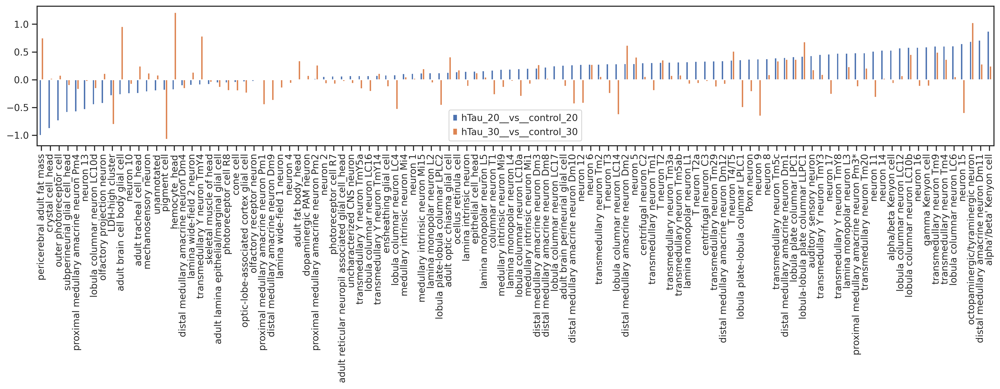

In [45]:
cellN_ratio_adfca_log2.sort_values(by='hTau_20__vs__control_20', inplace=True)
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2.plot(kind='bar')

In [46]:
cellN_ratio_adfca_log2

,hTau_20__vs__control_20,hTau_30__vs__control_30
pericerebral adult fat mass,-1.002822,0.752564
crystal cell_head,-0.877291,0.026245
outer photoreceptor cell,-0.738405,0.080831
subperineurial glial cell_head,-0.587784,-0.104999
proximal medullary amacrine neuron Pm4,-0.577516,-0.175388
...,...,...
lobula columnar neuron LC6,0.609108,0.052718
neuron 15,0.649255,-0.607627
octopaminergic/tyraminergic neuron,0.689056,1.026245
distal medullary amacrine neuron Dm11,0.710874,0.280002


In [47]:
neuronBroad_L = adata_adfcaHead.obs.adfca_annotation_broad.cat.categories[adata_adfcaHead.obs.adfca_annotation_broad.cat.categories.isin(['CNS neuron', 'sensory neuron'])].to_list()
neuronCt_L = list(set(adata_adfcaHead.obs.adfca_annotation[adata_adfcaHead.obs.adfca_annotation_broad.isin(neuronBroad_L)]) - set(['cone cell']))
neuronCt_L

['neuron 9',
 'lobula columnar neuron LC17',
 'medullary intrinsic neuron Mi4',
 'distal medullary amacrine neuron Dm10',
 'transmedullary Y neuron TmY5a',
 'photoreceptor cell R8',
 'uncharacterized CNS neuron',
 'lobula plate columnar LPC1',
 'olfactory projection neuron',
 'transmedullary neuron Tm9',
 'lobula columnar neuron LC6',
 'transmedullary neuron Tm29',
 'centrifugal neuron C2',
 'octopaminergic/tyraminergic neuron',
 'olfactory receptor neuron',
 'centrifugal neuron C3',
 'distal medullary amacrine neuron Dm12',
 'gamma Kenyon cell',
 'distal medullary amacrine neuron Dm1',
 'columnar neuron T1',
 'lamina intrinsic neuron',
 'photoreceptor cell R7',
 'lamina monopolar neuron L5',
 'proximal medullary amacrine neuron Pm3*',
 'lamina monopolar neuron L3',
 'neuron 11',
 'mechanosensory neuron',
 'medullary intrinsic neuron Mi9',
 'proximal medullary amacrine neuron Pm2',
 'LDH-high cluster',
 'transmedullary neuron Tm2',
 'distal medullary amacrine neuron Dm2',
 'neuron 4',


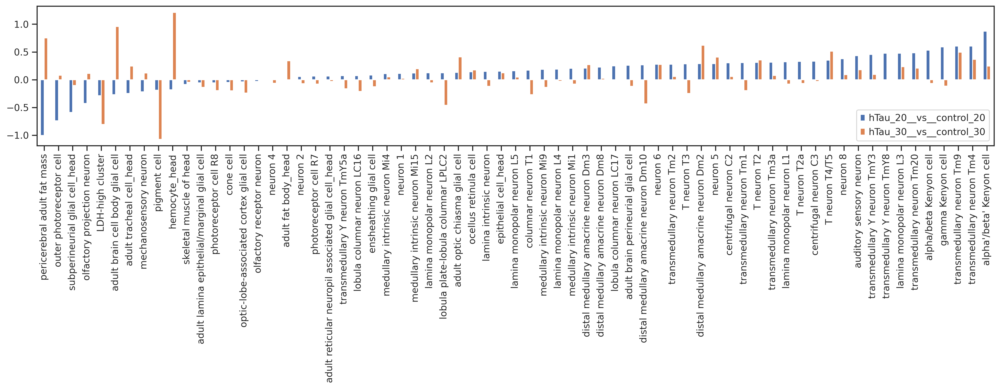

In [48]:
cellN_ratio_adfca_log2.sort_values(by='hTau_20__vs__control_20', inplace=True)
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2[cellN_ratio_adfca_log2.index.isin(celltypeN700_L)].plot(kind='bar')

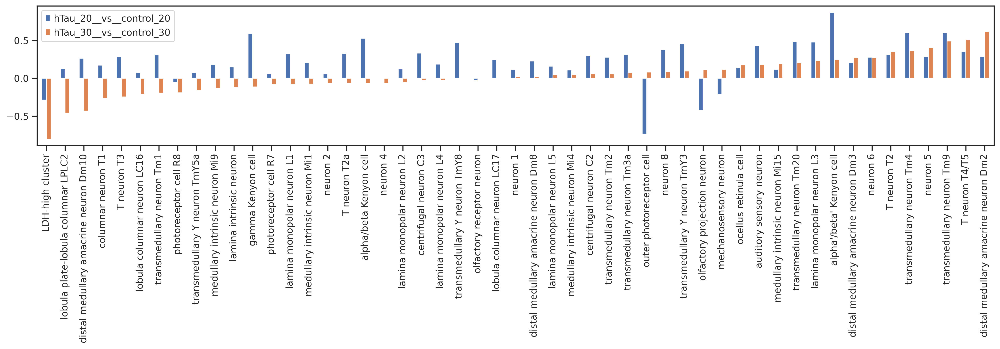

In [50]:
cellN_ratio_adfca_log2.sort_values(by='hTau_30__vs__control_30', inplace=True)
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2[ (cellN_ratio_adfca_log2.index.isin(celltypeN700_L)) & (cellN_ratio_adfca_log2.index.isin(neuronCt_L)) ].plot(kind='bar')

### adfca: genoAge

In [51]:
cellN_Df_adfca, cellN_ratio_adfca = cellN_cellRatio(adata_adfcaHead, 'genotype', 'adfca_annotation')

<ipython-input-17-ea2bf25e01e3>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)


In [52]:
cellN_ratio_adfca = cellN_ratio_adfca.T
cellN_ratio_adfca = cellN_ratio_adfca.astype(float) # [cellN_ratio_adfca.index.isin(celltypeN700_L)]
cellN_ratio_adfca

,control,hTau
LDH-high cluster,0.005858,0.003628
Poxn neuron,0.002132,0.002280
T neuron T2,0.003122,0.003923
T neuron T2a,0.004877,0.005509
T neuron T3,0.003575,0.003809
...,...,...
transmedullary neuron Tm5ab,0.000943,0.001092
transmedullary neuron Tm5c,0.000717,0.000931
transmedullary neuron Tm9,0.001849,0.002745
unannotated,0.072775,0.068652


In [53]:
cellN_ratio_adfca_log2 = pd.DataFrame(index=cellN_ratio_adfca.index.to_list())
cellN_ratio_adfca_log2['hTau__control'] = np.log2(cellN_ratio_adfca['hTau']/cellN_ratio_adfca['control'])

cellN_ratio_adfca_log2.sort_values(by='hTau__control', inplace=True)

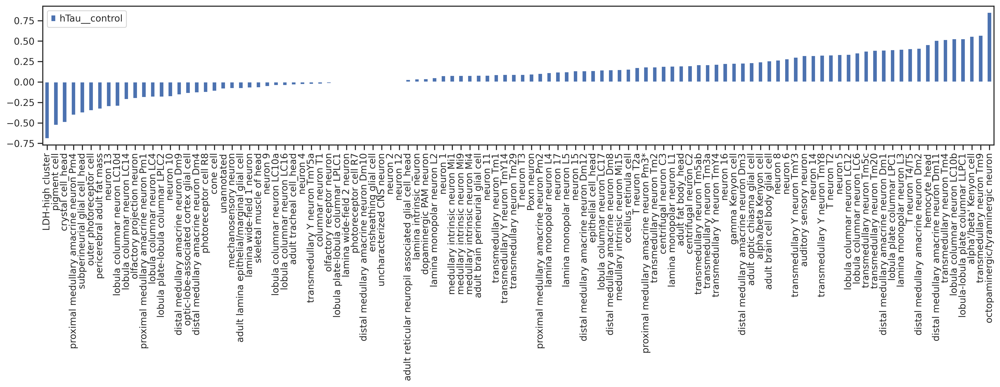

In [54]:
cellN_ratio_adfca_log2.sort_values(by='hTau__control', inplace=True)
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2.plot(kind='bar')

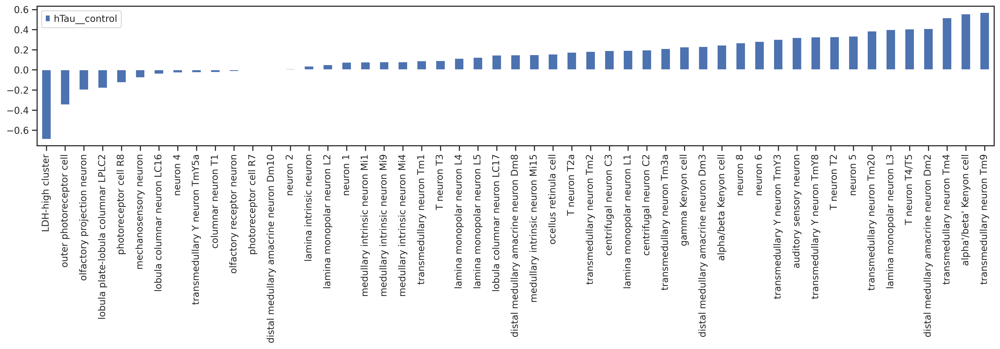

In [55]:
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2[ (cellN_ratio_adfca_log2.index.isin(celltypeN700_L)) & (cellN_ratio_adfca_log2.index.isin(neuronCt_L)) ].plot(kind='bar')

In [62]:
cellN_ratio_adfca_log2.head(10)

,hTau__control
LDH-high cluster,-0.691093
pigment cell,-0.527989
crystal cell_head,-0.492573
proximal medullary amacrine neuron Pm4,-0.405110
subperineurial glial cell_head,-0.377444
outer photoreceptor cell,-0.348342
pericerebral adult fat mass,-0.329776
neuron 13,-0.299927
lobula columnar neuron LC10d,-0.293853
lobula columnar neuron LC14,-0.214287


In [64]:
cellN_ratio_adfca_log2.index.to_list()

['LDH-high cluster',
 'pigment cell',
 'crystal cell_head',
 'proximal medullary amacrine neuron Pm4',
 'subperineurial glial cell_head',
 'outer photoreceptor cell',
 'pericerebral adult fat mass',
 'neuron 13',
 'lobula columnar neuron LC10d',
 'lobula columnar neuron LC14',
 'olfactory projection neuron',
 'proximal medullary amacrine neuron Pm1',
 'lobula columnar neuron LC4',
 'lobula plate-lobula columnar LPLC2',
 'neuron 10',
 'distal medullary amacrine neuron Dm9',
 'optic-lobe-associated cortex glial cell',
 'distal medullary amacrine neuron Dm4',
 'photoreceptor cell R8',
 'cone cell',
 'unannotated',
 'mechanosensory neuron',
 'adult lamina epithelial/marginal glial cell',
 'lamina wide-field 1 neuron',
 'skeletal muscle of head',
 'neuron 9',
 'lobula columnar neuron LC10a',
 'lobula columnar neuron LC16',
 'adult tracheal cell_head',
 'neuron 4',
 'transmedullary Y neuron TmY5a',
 'columnar neuron T1',
 'olfactory receptor neuron',
 'lobula plate-lobula columnar LPLC1',
 '

In [67]:
ct_L = [ "alpha'/beta' Kenyon cell", 'alpha/beta Kenyon cell', 'gamma Kenyon cell', 'centrifugal neuron C2', 'transmedullary neuron Tm3a', 'outer photoreceptor cell']

In [69]:
adfca_Ratio = cellN_ratio_adfca_log2.loc[ct_L, :]
adfca_Ratio

,hTau__control
alpha'/beta' Kenyon cell,0.557416
alpha/beta Kenyon cell,0.245350
gamma Kenyon cell,0.228744
centrifugal neuron C2,0.198080
transmedullary neuron Tm3a,0.211562
outer photoreceptor cell,-0.348342


### hTau[P301L]: genotype

In [56]:
cellN_Df_tauP301L, cellN_ratio_tauP301L = cellN_cellRatio(adata_Neuron2023, 'genotype', 'linearR_annotation')

<ipython-input-17-ea2bf25e01e3>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)


In [57]:
cellN_ratio_tauP301L = cellN_ratio_tauP301L.T.astype(float)
# cellN_ratio_tauP301L = cellN_ratio_tauP301L[cellN_ratio_tauP301L.index.isin(celltypeN700_L)]
cellN_ratio_tauP301L

,P301L,mini
A/B*-KC,0.007013,0.008750
A/B-KC,0.020039,0.020249
AstA/NPF,0.000286,0.000322
Astrocyte-like,0.009552,0.010134
C2,0.005661,0.011850
...,...,...
Tyraminergic/Octopaminergic,0.000758,0.000664
adPN/C15&kn,0.007892,0.006522
dorsal_Fan-shaped_Body_A,0.001055,0.001043
dorsal_Fan-shaped_Body_B,0.000385,0.000806


In [58]:
cellN_ratio_tauP301L_log2 = pd.DataFrame(index=cellN_ratio_tauP301L.index.to_list())
cellN_ratio_tauP301L_log2['P301L__mini'] = np.log2(cellN_ratio_tauP301L['P301L']/cellN_ratio_tauP301L['mini'])

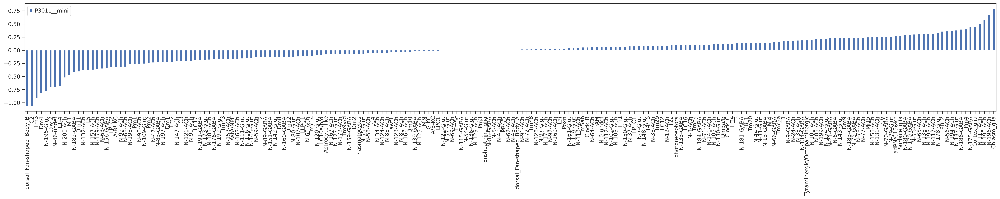

In [59]:
cellN_ratio_tauP301L_log2.sort_values(by='P301L__mini', inplace=True)

with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2.plot(kind='bar')

In [70]:
cellN_ratio_tauP301L_log2.index.to_list()

['dorsal_Fan-shaped_Body_B',
 'C2',
 'Tm3',
 'Dm4',
 'N-195-Glut',
 'Lawf2',
 'N-46-undef',
 'L1-4',
 'N-200-ACh',
 'Mi1',
 'N-182-GABA',
 'Dm11',
 'N-132-ACh',
 'L5',
 'N-157-ACh',
 'N-179-ACh',
 'N-63-ACh',
 'N-156-GABA',
 'LPLC2',
 'A/B*-KC',
 'N-99-ACh',
 'N-68-ACh',
 'N-198-ACh',
 'Pm1',
 'N-96-ACh',
 'N-109-Glut',
 'Pm2',
 'N-47-ACh',
 'N-83-GABA',
 'N-197-ACh',
 'Dm1',
 'Tm2',
 'N-147-ACh',
 'C3',
 'N-121-ACh',
 'N-90-ACh',
 'LC17',
 'N-191-GABA',
 'N-173-Glut',
 'N-185-ACh',
 'N-176-GABA',
 'N-192-Glut',
 'TmY3',
 'N-153-ACh',
 'AstA/NPF',
 'N-163-ACh',
 'N-111-Glut',
 'N-116-Glut',
 'N-165-Glut',
 'N-59-ACh',
 'T2',
 'N-89-GABA',
 'N-151-GABA',
 'N-142-Glut',
 'Dm8',
 'N-160-GABA',
 'Dm12',
 'N-80-Glut',
 'N-107-ACh',
 'LLPC1',
 'N-60-ACh',
 'TmY14',
 'N-120-Glut',
 'LC10a/b/d',
 'Astrocyte-like',
 'N-167-ACh',
 'N-127-Glut',
 'N-172-ACh',
 'Tm9v/d',
 'N-159-GABA',
 'Dm2',
 'Plasmatocytes',
 'N-55-Glut',
 'N-58-ACh',
 'LC4',
 'N-34-ACh',
 'N-124-ACh',
 'N-88-ACh',
 'Lawf1',
 '

In [72]:
tauP301_ct_L = ['A/B*-KC', 'A/B-KC', 'G-KC', 'C2', 'Tm3', 'photoreceptors']

In [73]:
cellN_ratio_tauP301L_log2.loc[tauP301_ct_L,:]

,P301L__mini
A/B*-KC,-0.319206
A/B-KC,-0.015029
G-KC,-0.017973
C2,-1.065715
Tm3,-0.908539
photoreceptors,0.100977


In [75]:
elife_ratio_Df = pd.read_csv('/data/tcl/Project/ADFCA/Analysis/Figure_2023NeuronTau/neuronVulnerableNeuron_compare.tsv', sep='\t')
elife_ratio_Df

,annotation,log2FC_eLife
0,a'/b'-KC,-1.640549
1,a/b-KC,-1.468277
2,G-KC,-2.643038
3,C2,0.079642
4,Tm3,0.468077
5,photoreceptor,1.179713


In [88]:
cellN_ratio_tauP301L_log2.loc[tauP301_ct_L, 'P301L__mini']

A/B*-KC          -0.319206
A/B-KC           -0.015029
G-KC             -0.017973
C2               -1.065715
Tm3              -0.908539
photoreceptors    0.100977
Name: P301L__mini, dtype: float64

In [99]:
ratioCompare_Df = pd.DataFrame(index=elife_ratio_Df.annotation.to_list())
ratioCompare_Df['Tau[R406W] eLife_2023 (scRNA-seq)'] = elife_ratio_Df.iloc[:,1].to_list()
ratioCompare_Df['Tau[P301L] Neuron2023 (scRNA-seq)'] = cellN_ratio_tauP301L_log2.loc[tauP301_ct_L, 'P301L__mini'].to_list()
ratioCompare_Df['Tau(0N4R) ADFCA (snRNA-seq)'] = adfca_Ratio.loc[ct_L, 'hTau__control'].to_list()

ratioCompare_Df

,Tau[R406W] eLife_2023 (scRNA-seq),Tau[P301L] Neuron2023 (scRNA-seq),Tau(0N4R) ADFCA (snRNA-seq)
a'/b'-KC,-1.640549,-0.319206,0.557416
a/b-KC,-1.468277,-0.015029,0.245350
G-KC,-2.643038,-0.017973,0.228744
C2,0.079642,-1.065715,0.198080
Tm3,0.468077,-0.908539,0.211562
photoreceptor,1.179713,0.100977,-0.348342


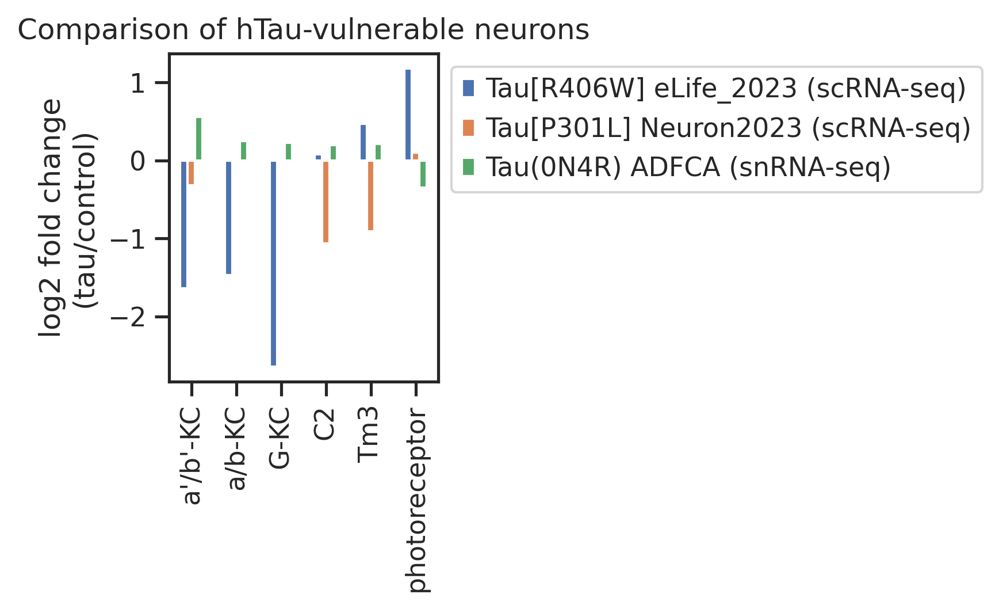

In [105]:
with rc_context({'figure.figsize': (2, 2.5)}):
    ratioCompare_Df.plot(kind='bar',)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.title('Comparison of hTau-vulnerable neurons')
    plt.ylabel('log2 fold change\n(tau/control)')
    
    plt.savefig(f'{Neuron2023PicFolder}/ratioCompare_Df.pdf', bbox_inches='tight')

In [102]:
figureTauComPicFolder

'Analysis/Figure/Figure_TauCompare/pic'

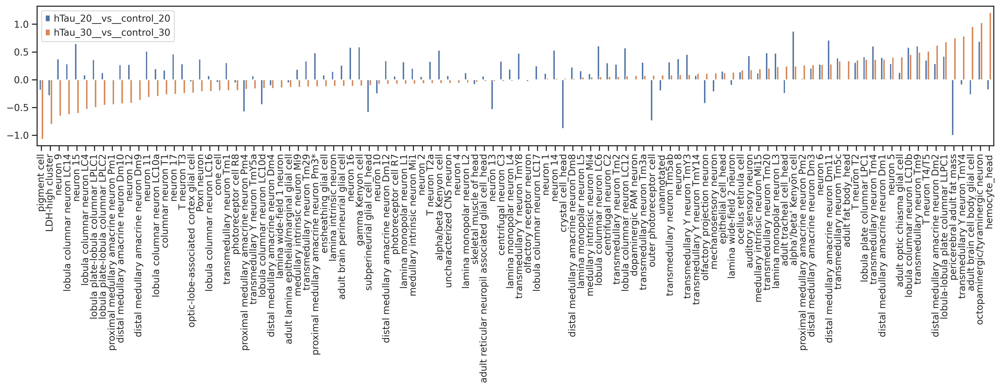

In [97]:
cellN_ratio_adfca_log2.sort_values(by='hTau_30__vs__control_30', inplace=True)
with rc_context({'figure.figsize': (20, 3)}):
    cellN_ratio_adfca_log2.plot(kind='bar')

In [80]:
cellN_Df_adfca, cellN_ratio_adfca = cellN_cellRatio(adata_adfcaHead, 'genotype', 'adfca_annotation')

<ipython-input-11-ea2bf25e01e3>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)


In [81]:
cellN_ratio_adfca = cellN_ratio_adfca.T
cellN_ratio_adfca = cellN_ratio_adfca.astype(float) # [cellN_ratio_adfca.index.isin(celltypeN700_L)]
cellN_ratio_adfca

,control,hTau
LDH-high cluster,0.005858,0.003628
Poxn neuron,0.002132,0.002280
T neuron T2,0.003122,0.003923
T neuron T2a,0.004877,0.005509
T neuron T3,0.003575,0.003809
...,...,...
transmedullary neuron Tm5ab,0.000943,0.001092
transmedullary neuron Tm5c,0.000717,0.000931
transmedullary neuron Tm9,0.001849,0.002745
unannotated,0.072775,0.068652


In [82]:
cellN_ratio_adfca_log2 = pd.DataFrame(index=cellN_ratio_adfca.index.to_list())
cellN_ratio_adfca_log2['hTau__vs__control'] = np.log2(cellN_ratio_adfca['hTau']/cellN_ratio_adfca['control'])

cellN_ratio_adfca_log2.sort_values(by='hTau__vs__control', inplace=True)

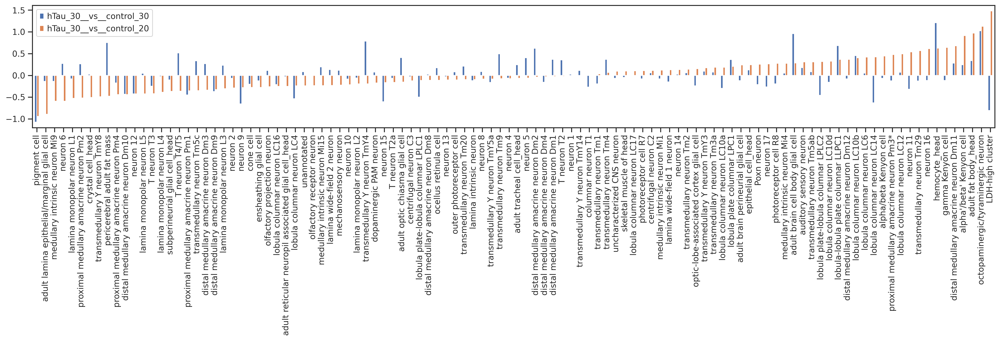

In [93]:
with rc_context({'figure.figsize': (23, 3)}):
    cellN_ratio_adfca_log2.plot(kind='bar')

In [58]:
adata_Neuron2023

AnnData object with n_obs × n_vars = 159874 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad', 'genoAge'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [126]:
adata_Neuron2023[ (adata_Neuron2023.obs.age == '45d') ].obs

,genotype,date,age,n_genes,n_counts,mt_frac,cell_types_integrated,broad_annotation,neurotransmitter,UMAP_x,...,cell_types_integrated_label_transfer,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,true,linearR_annotation,annotation_broad,genoAge
AAACCCAAGTAAGACT-1-20220412_P301L_45d,P301L,NaN,45d,1409,2782.83520,0.008032,NaN,NaN,NaN,3.358510,...,N-5-ACh,1409,2782.835205,22.351107,0.803178,106,NaN,N-5-ACh,Neuron,P301L_45d
AAACCCAAGTTGTCAC-1-20220412_P301L_45d,P301L,NaN,45d,1765,4452.88600,0.005311,NaN,NaN,NaN,2.172630,...,N-3-ACh,1765,4452.885742,23.649239,0.531099,26,NaN,N-3-ACh,Neuron,P301L_45d
AAACCCACATTATGCG-1-20220412_P301L_45d,P301L,NaN,45d,881,1694.74910,0.001808,NaN,NaN,NaN,11.732514,...,N-81-ACh,881,1694.749146,3.064435,0.180819,46,NaN,N-81-ACh,Neuron,P301L_45d
AAACCCATCCTGTAGA-1-20220412_P301L_45d,P301L,NaN,45d,784,1336.34100,0.006577,NaN,NaN,NaN,7.826670,...,TmY14,784,1336.341064,8.788693,0.657668,102,NaN,TmY14,Neuron,P301L_45d
AAACCCATCGTGCATA-1-20220412_P301L_45d,P301L,NaN,45d,819,1654.51950,0.000000,NaN,NaN,NaN,7.420219,...,Tm1,819,1654.519531,0.000000,0.000000,33,NaN,Tm1,Neuron,P301L_45d
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGCAGCCTACG-1-20220502_mini_45d,mini,NaN,45d,517,715.58417,0.000562,NaN,NaN,NaN,7.168665,...,100,517,715.584106,0.401946,0.056170,125,NaN,N-137-Glut,Neuron,mini_45d
TTTGTTGGTTGGCCGT-1-20220502_mini_45d,mini,NaN,45d,747,1563.25460,0.122535,NaN,NaN,NaN,15.107158,...,Tm2,747,1563.254639,191.552841,12.253464,40,NaN,Tm2,Neuron,mini_45d
TTTGTTGTCGCCGATG-1-20220502_mini_45d,mini,NaN,45d,1256,2514.68000,0.005784,NaN,NaN,NaN,4.652971,...,N-0-undef,1256,2514.679932,14.545169,0.578410,82,NaN,N-0-undef,Neuron,mini_45d
TTTGTTGTCTAGTTCT-1-20220502_mini_45d,mini,NaN,45d,826,1267.95040,0.006793,NaN,NaN,NaN,6.348648,...,65,826,1267.950317,8.613487,0.679324,26,NaN,N-6-GABA,Neuron,mini_45d


In [129]:
adata_Neuron2023[ (adata_Neuron2023.obs.age == '5d') ].obs.date.value_counts()

date
2020-11-16    13964
2020-06-18    12530
2020-09-23    10093
Name: count, dtype: int64

In [123]:
adata_Neuron2023.obs.date.value_counts()

date
2020-12-02    14276
2020-11-16    13964
2020-06-18    12530
2020-11-23    12336
2020-11-26    12154
2020-09-23    10093
Name: count, dtype: int64

In [115]:
cellN_Df_tauP301L, cellN_ratio_tauP301L = cellN_cellRatio(adata_Neuron2023, 'genoAge', 'linearR_annotation')

<ipython-input-11-ea2bf25e01e3>:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cellN_Df = pd.DataFrame(adata.obs.groupby([sampleCol, annotCol]).size()).unstack(annotCol)


In [116]:
cellN_ratio_tauP301L = cellN_ratio_tauP301L.T.astype(float)
# cellN_ratio_tauP301L = cellN_ratio_tauP301L[cellN_ratio_tauP301L.index.isin(celltypeN700_L)]
cellN_ratio_tauP301L

,mini_5d,mini_25d,mini_45d,P301L_5d,P301L_25d,P301L_45d
A/B*-KC,0.005366,0.010513,0.009328,0.006633,0.006553,0.007283
A/B-KC,0.015576,0.019494,0.021969,0.016292,0.021828,0.020447
AstA/NPF,0.000285,0.000317,0.000336,0.000193,0.000353,0.000288
Astrocyte-like,0.008928,0.008030,0.011130,0.007534,0.007461,0.010862
C2,0.012299,0.013419,0.011252,0.010690,0.005041,0.004478
...,...,...,...,...,...,...
Tyraminergic/Octopaminergic,0.000522,0.000740,0.000687,0.000708,0.000605,0.000827
adPN/C15&kn,0.006126,0.007977,0.006229,0.005216,0.008923,0.008272
dorsal_Fan-shaped_Body_A,0.001140,0.001162,0.000977,0.000902,0.001008,0.001115
dorsal_Fan-shaped_Body_B,0.000855,0.000792,0.000794,0.000322,0.000454,0.000378


In [117]:
cellN_ratio_tauP301L_log2 = pd.DataFrame(index=cellN_ratio_tauP301L.index.to_list())
cellN_ratio_tauP301L_log2['P301L_5d__vs__mini_5d'] = np.log2(cellN_ratio_tauP301L['P301L_5d']/cellN_ratio_tauP301L['mini_5d'])
cellN_ratio_tauP301L_log2['P301L_25d__vs__mini_25d'] = np.log2(cellN_ratio_tauP301L['P301L_25d']/cellN_ratio_tauP301L['mini_25d'])
cellN_ratio_tauP301L_log2['P301L_45d__vs__mini_45d'] = np.log2(cellN_ratio_tauP301L['P301L_45d']/cellN_ratio_tauP301L['mini_45d'])

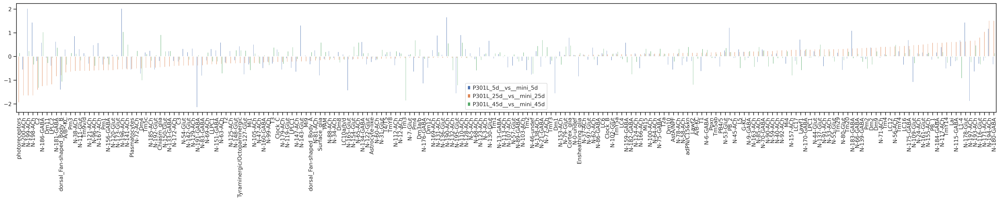

In [118]:
cellN_ratio_tauP301L_log2.sort_values(by='P301L_25d__vs__mini_25d', inplace=True)

with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2.plot(kind='bar')

In [119]:
cellN_ratio_tauP301L_log2

,P301L_5d__vs__mini_5d,P301L_25d__vs__mini_25d,P301L_45d__vs__mini_45d
photoreceptors,inf,-1.942065,0.153261
N-200-ACh,-0.560597,-1.652558,inf
N-199-ACh,2.024366,-1.652558,0.236250
N-198-ACh,1.439403,-1.652558,-0.348712
C2,-0.202365,-1.412424,-1.329268
...,...,...,...
N-193-ACh,-0.643059,0.682426,0.475716
N-116-Glut,-0.313957,0.806873,-0.343532
N-171-ACh,-0.188628,1.047882,-0.055930
N-194-ACh,1.176369,1.517367,0.013858


In [142]:
cellN_ratio_tauP301L_log2[    cellN_ratio_tauP301L_log2.index.isin(['C2', 'C3', 'Mi15', 'T2', 'T3', 'Tm1', 'Tm3']) ]

,P301L_5d__vs__mini_5d,P301L_25d__vs__mini_25d,P301L_45d__vs__mini_45d
C2,-0.202365,-1.412424,-1.329268
C3,-0.226413,-0.401750,-0.141783
T2,-0.264204,-0.302061,-0.023704
T3,-0.307830,-0.244900,0.385711
Tm3,-0.022940,-0.080087,-1.861930
Tm1,-0.092818,-0.016672,0.139109
Mi15,0.149897,0.115626,0.332175


In [144]:
cellN_ratio_tauP301L_log2[ cellN_ratio_tauP301L_log2.index.isin(['Dm1', 'Dm4', 'Pm4', 'T1']) ]

,P301L_5d__vs__mini_5d,P301L_25d__vs__mini_25d,P301L_45d__vs__mini_45d
Dm4,-0.730522,-0.515055,-1.015288
Pm4,-0.648059,-0.067596,0.689616
Dm1,-1.560597,0.031940,-0.093057
T1,-0.628983,0.169444,0.323609


In [69]:
cellN_ratio_tauP301L_log2 = pd.DataFrame(index=cellN_ratio_tauP301L.index.to_list())
cellN_ratio_tauP301L_log2['P301L_25d__vs__mini_25d'] = np.log2(cellN_ratio_tauP301L['P301L_25d']/cellN_ratio_tauP301L['mini_25d'])
cellN_ratio_tauP301L_log2['P301L_45d__vs__mini_45d'] = np.log2(cellN_ratio_tauP301L['P301L_45d']/cellN_ratio_tauP301L['mini_45d'])

cellN_ratio_tauP301L_log2.sort_values(by='P301L_45d__vs__mini_45d', inplace=True)

In [120]:
cellN_ratio_tauP301L_log2_5d = cellN_ratio_tauP301L_log2[cellN_ratio_tauP301L_log2.P301L_5d__vs__mini_5d < 0].sort_values(by='P301L_5d__vs__mini_5d')
cellN_ratio_tauP301L_log2_25d = cellN_ratio_tauP301L_log2[cellN_ratio_tauP301L_log2.P301L_25d__vs__mini_25d < 0].sort_values(by='P301L_25d__vs__mini_25d')
cellN_ratio_tauP301L_log2_45d = cellN_ratio_tauP301L_log2[cellN_ratio_tauP301L_log2.P301L_45d__vs__mini_45d < 0].sort_values(by='P301L_45d__vs__mini_45d')

In [145]:
cellN_ratio_tauP301L_log2_5d = cellN_ratio_tauP301L_log2.sort_values(by='P301L_5d__vs__mini_5d')
cellN_ratio_tauP301L_log2_25d = cellN_ratio_tauP301L_log2.sort_values(by='P301L_25d__vs__mini_25d')
cellN_ratio_tauP301L_log2_45d = cellN_ratio_tauP301L_log2.sort_values(by='P301L_45d__vs__mini_45d')

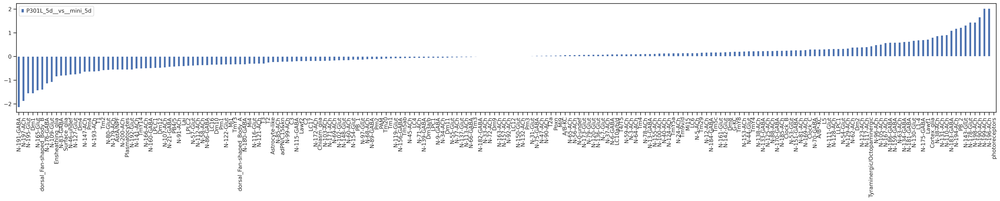

In [146]:
with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2_5d.iloc[:,:1].plot(kind='bar')

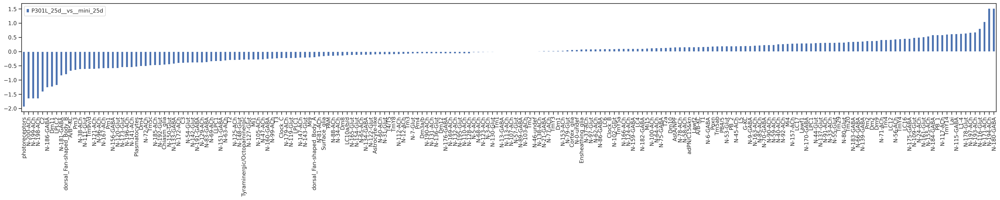

In [147]:
with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2_25d.iloc[:, [1]].plot(kind='bar')

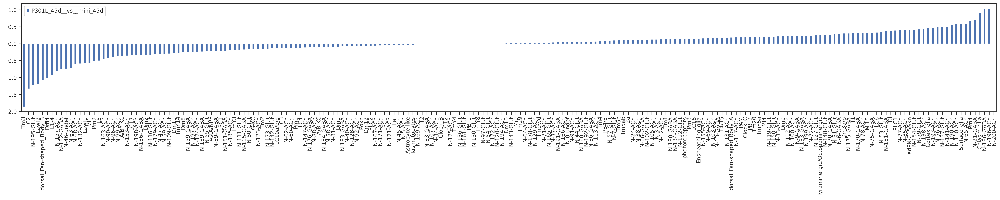

In [148]:
with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2_45d.iloc[:, [2]].plot(kind='bar')

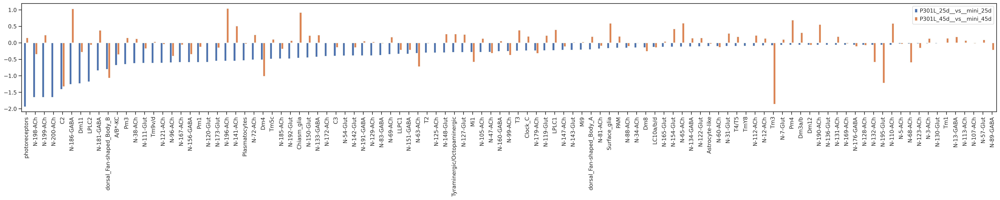

In [104]:
with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2_25d.plot(kind='bar')

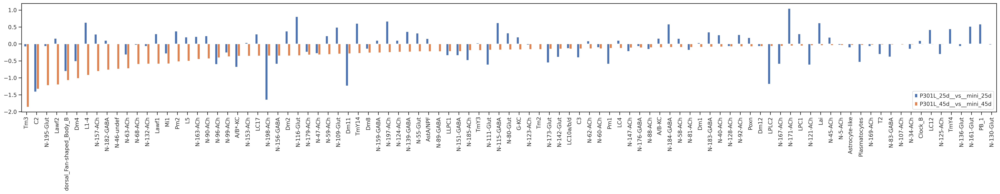

In [105]:
with rc_context({'figure.figsize': (35, 4)}):
    cellN_ratio_tauP301L_log2_45d.plot(kind='bar')

In [106]:
cellN_ratio_tauP301L_log2_25d

,P301L_25d__vs__mini_25d,P301L_45d__vs__mini_45d
photoreceptors,-1.942065,0.153261
N-198-ACh,-1.652558,-0.348712
N-199-ACh,-1.652558,0.236250
N-200-ACh,-1.652558,inf
C2,-1.412424,-1.329268
...,...,...
N-13-GABA,-0.014425,0.181355
N-113-ACh,-0.012101,0.070827
N-107-ACh,-0.004860,-0.021547
N-57-Glut,-0.002304,0.091134


# Identify DEGs in Tau

## Load h5ad and subset age & genotype

In [138]:
adata_Neuron2023 = sc.read(f'{Neuron2023Folder}/4.annotTransfer_annotBroad.h5ad')
adata_Neuron2023

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 264121 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [142]:
adata_Neuron2023.obs.age.value_counts()

age
45d    121108
25d     76300
5d      66713
Name: count, dtype: int64

In [146]:
adata_Neuron2023_forTau = adata_Neuron2023[ (adata_Neuron2023.obs.age.isin(['25d', '45d'])) & (adata_Neuron2023.obs.genotype.isin(['mini', 'P301L'])) & (adata_Neuron2023.obs['annotation_broad'] == 'Neuron') ] #
adata_Neuron2023_forTau

View of AnnData object with n_obs × n_vars = 152043 × 2000
    obs: 'genotype', 'date', 'age', 'n_genes', 'n_counts', 'mt_frac', 'cell_types_integrated', 'broad_annotation', 'neurotransmitter', 'UMAP_x', 'UMAP_y', 'cell_types_integrated_label_transfer', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'true', 'linearR_annotation', 'annotation_broad'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'age_colors', 'genotype_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [148]:
adata_Neuron2023_forTau.obs.genotype.value_counts()

genotype
mini     80497
P301L    71546
Name: count, dtype: int64

## Identify DEGs: compared between different genotypes using whole neurons

In [150]:
adata_Neuron2023_forTau.uns['log1p']["base"] = None

In [152]:
csvFile=f'{degFolder}/panNeuron_tau_vs_mini.csv'

sc.tl.rank_genes_groups(adata_Neuron2023_forTau, groupby='genotype', reference='mini', method='wilcoxon')

result = adata_Neuron2023_forTau.uns['rank_genes_groups']
groups = result['names'].dtype.names
degDf =pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges']})

degDf.to_csv(csvFile, index=False)

ranking genes


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:05)


# GO analysis

## Load GO files

### Load ontologies and associations

In [153]:
import goatools

In [154]:
goatools.__version__

'1.3.1'

In [155]:
!pwd

/data/tcl/Project/ADFCA


In [156]:
from goatools.obo_parser import GODag
from goatools.anno.gaf_reader import GafReader

obodag = GODag("../../Resource/GO/go-basic.obo")
ogaf = GafReader("../../Resource/GO/FlyBase_gene_association_09082022.gaf") # FlyBase file

../../Resource/GO/go-basic.obo: fmt(1.2) rel(2022-07-01) 47,008 Terms
HMS:0:00:08.398499 121,359 annotations READ: ../../Resource/GO/FlyBase_gene_association_09082022.gaf 


In [157]:
ns2assc = ogaf.get_ns2assc()

### Load Background gene set

In [158]:
geneid2symbol_Df=pd.read_table('cellrangerSummary/features.tsv', header=None, index_col=0)
geneid2symbol_Df.head()

,1,2
0,,
FBgn0267594,CR45932,Gene Expression
FBgn0259849,Su(Ste):CR42418,Gene Expression
FBgn0085494,Mst77Y-16Psi,Gene Expression
FBgn0085506,CG40635,Gene Expression
FBgn0259870,Su(Ste):CR42439,Gene Expression


In [ ]:
geneid2symbol_D= dict(zip(geneid2symbol_Df.index.to_list(), geneid2symbol_Df[1].to_list()))

In [ ]:
symbol2geneid_D= dict(zip(geneid2symbol_Df[1].to_list(), geneid2symbol_Df.index.to_list()))

In [159]:
adata_5_25.var

,FlyBaseID,geneName
7SLRNA:CR32864,FBgn0000003,7SLRNA:CR32864
a,FBgn0000008,a
abd-A,FBgn0000014,abd-A
Abd-B,FBgn0000015,Abd-B
Abl,FBgn0000017,Abl
...,...,...
Datp,FBgn0287788,Datp
QF2w,QF2w,QF2w
a-syn[A53T],asynA53T,a-syn[A53T]
smGdP::V5,smGdPV5,smGdP::V5


In [160]:
geneid2symbol_D= dict(zip(adata_5_25.var.FlyBaseID.to_list(), adata_5_25.var.geneName.to_list() ))

In [161]:
symbol2geneid_D= dict(zip(adata_5_25.var.geneName.to_list(), adata_5_25.var.FlyBaseID.to_list() ))

### Initialize a GOEA object 

In [162]:
from goatools.goea.go_enrichment_ns import GOEnrichmentStudyNS

goeaobj = GOEnrichmentStudyNS(
        geneid2symbol_D, # List of fly protein-coding genes
        ns2assc, # geneid/GO associations
        obodag, # Ontologies
        propagate_counts = False,
        alpha = 0.05, # default significance cut-off
        methods = ['fdr_bh']) # defult multipletest correction method


Load BP Ontology Enrichment Analysis ...
 59% 10,316 of 17,616 population items found in association

Load CC Ontology Enrichment Analysis ...
 57%  9,964 of 17,616 population items found in association

Load MF Ontology Enrichment Analysis ...
 53%  9,315 of 17,616 population items found in association


## detect GOs

In [177]:
deg_Df = pd.read_csv(f'{degFolder}/panNeuron_tau_vs_mini.csv')
deg_Df.P301L_names = deg_Df.P301L_names.astype(str)

deg_Df

,P301L_names,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges
0,tau[P301L],0.0,0.0,12.510933
1,Ank2,0.0,0.0,0.680792
2,lncRNA:alphagamma-element:CR32865,0.0,0.0,4.074444
3,kis,0.0,0.0,0.740566
4,unc-13,0.0,0.0,0.428607
...,...,...,...,...
17612,RpL38,0.0,0.0,-0.444091
17613,RpL21,0.0,0.0,-0.422296
17614,RpL37a,0.0,0.0,-0.431880
17615,RpS18,0.0,0.0,-0.458340


In [178]:
deg_Df_e05 = deg_Df[deg_Df.P301L_pvals_adj < 0.05]
deg_Df_e05

,P301L_names,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges
0,tau[P301L],0.0,0.0,12.510933
1,Ank2,0.0,0.0,0.680792
2,lncRNA:alphagamma-element:CR32865,0.0,0.0,4.074444
3,kis,0.0,0.0,0.740566
4,unc-13,0.0,0.0,0.428607
...,...,...,...,...
17612,RpL38,0.0,0.0,-0.444091
17613,RpL21,0.0,0.0,-0.422296
17614,RpL37a,0.0,0.0,-0.431880
17615,RpS18,0.0,0.0,-0.458340


In [181]:
# GOs
id_L=[symbol2geneid_D[x] for x in deg_Df_e05.P301L_names.to_list() if (x in symbol2geneid_D.keys()) ]
id_L=[x for x in id_L if x.startswith('FBgn') ]

goea_results_all = goeaobj.run_study(id_L)
goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < 0.01]

goeaobj.wr_tsv(f"{degFolder}/degGOs_TauVsMini_symbols.tsv", goea_results_sig, itemid2name=geneid2symbol_D)
goeaobj.wr_tsv(f"{degFolder}/degGos_TauVsMini_geneids.tsv", goea_results_sig)


Runing BP Ontology Analysis: current study set of 3105 IDs.
 85%  2,650 of  3,105 study items found in association
100%  3,105 of  3,105 study items found in population(17616)
Calculating 5,172 uncorrected p-values using fisher_scipy_stats
   5,172 terms are associated with 10,316 of 17,616 population items
   3,364 terms are associated with  2,650 of  3,105 study items
  METHOD fdr_bh:
     665 GO terms found significant (< 0.05=alpha) (656 enriched +   9 purified): statsmodels fdr_bh
   2,195 study items associated with significant GO IDs (enriched)
      65 study items associated with significant GO IDs (purified)

Runing CC Ontology Analysis: current study set of 3105 IDs.
 84%  2,607 of  3,105 study items found in association
100%  3,105 of  3,105 study items found in population(17616)
Calculating 1,094 uncorrected p-values using fisher_scipy_stats
   1,094 terms are associated with  9,964 of 17,616 population items
     784 terms are associated with  2,607 of  3,105 study items


In [183]:
tauGO_Df = pd.read_csv(f"{degFolder}/degGOs_TauVsMini_symbols.tsv", sep='\t')
tauGO_Df['group'] = 'hTau'
tauGO_Df['-log10FDR'] = -np.log10(tauGO_Df.p_fdr_bh)
tauGO_Df = tauGO_Df[tauGO_Df.enrichment == 'e']
tauGO_Df_top10 =tauGO_Df.iloc[:10,:]
tauGO_Df_top10

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
0,GO:0002181,BP,e,cytoplasmic translation,82/3105,99/17616,1.448811e-45,8,82,7.493249e-42,"RpL10, RpL10Ab, RpL11, RpL12, RpL13, RpL13A, R...",hTau,41.125330
1,GO:0007411,BP,e,axon guidance,104/3105,165/17616,1.140326e-38,8,104,2.948884e-35,"14-3-3epsilon, AP-1sigma, Abl, Acsl, Alk, CG44...",hTau,34.530342
2,GO:0006468,BP,e,protein phosphorylation,95/3105,195/17616,1.540475e-23,6,95,2.655779e-20,"Ack, Ack-like, Akt1, Alk, Atg1, CASK, CG17528,...",hTau,19.575808
3,GO:0048813,BP,e,dendrite morphogenesis,66/3105,111/17616,5.941956e-23,9,66,7.682949e-20,"Abl, BuGZ, Cul3, Dark, Dhc64C, Dlic, Dref, EcR...",hTau,19.114472
4,GO:0050808,BP,e,synapse organization,45/3105,60/17616,2.963678e-22,5,45,3.065628e-19,"ATP6AP2, Appl, Atg1, Blos1, CG13506, CG34353, ...",hTau,18.513481
5,GO:0048749,BP,e,compound eye development,63/3105,108/17616,2.357137e-21,6,63,2.031852e-18,"AP-1sigma, ATP6AP2, Abl, Afti, Amun, Arf102F, ...",hTau,17.692108
6,GO:0008340,BP,e,determination of adult lifespan,83/3105,172/17616,2.117841e-20,2,83,1.564782e-17,"14-3-3epsilon, ATPsynD, Atg8a, Atpalpha, Btk29...",hTau,16.805546
7,GO:0007268,BP,e,chemical synaptic transmission,56/3105,94/17616,9.684494e-20,7,56,6.261026e-17,"5-HT1A, 5-HT1B, 5-HT2B, 5-HT7, Abl, Ace, Acsl,...",hTau,16.203355
8,GO:0007476,BP,e,imaginal disc-derived wing morphogenesis,68/3105,129/17616,1.304034e-19,5,68,7.493850e-17,"Arf51F, Arf79F, CG30069, Cbl, Chd1, Cul3, Dad,...",hTau,16.125295
9,GO:0006357,BP,e,regulation of transcription by RNA polymerase II,205/3105,640/17616,1.900333e-19,10,205,9.828524e-17,"Ada2b, Alh, Asx, Atf3, Atf6, Axud1, BEAF-32, B...",hTau,16.007512


In [229]:
tauGO_Df.head(50)

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
0,GO:0002181,BP,e,cytoplasmic translation,82/3105,99/17616,1.448811e-45,8,82,7.493249e-42,"RpL10, RpL10Ab, RpL11, RpL12, RpL13, RpL13A, R...",hTau,41.125330
1,GO:0007411,BP,e,axon guidance,104/3105,165/17616,1.140326e-38,8,104,2.948884e-35,"14-3-3epsilon, AP-1sigma, Abl, Acsl, Alk, CG44...",hTau,34.530342
2,GO:0006468,BP,e,protein phosphorylation,95/3105,195/17616,1.540475e-23,6,95,2.655779e-20,"Ack, Ack-like, Akt1, Alk, Atg1, CASK, CG17528,...",hTau,19.575808
3,GO:0048813,BP,e,dendrite morphogenesis,66/3105,111/17616,5.941956e-23,9,66,7.682949e-20,"Abl, BuGZ, Cul3, Dark, Dhc64C, Dlic, Dref, EcR...",hTau,19.114472
4,GO:0050808,BP,e,synapse organization,45/3105,60/17616,2.963678e-22,5,45,3.065628e-19,"ATP6AP2, Appl, Atg1, Blos1, CG13506, CG34353, ...",hTau,18.513481
5,GO:0048749,BP,e,compound eye development,63/3105,108/17616,2.357137e-21,6,63,2.031852e-18,"AP-1sigma, ATP6AP2, Abl, Afti, Amun, Arf102F, ...",hTau,17.692108
6,GO:0008340,BP,e,determination of adult lifespan,83/3105,172/17616,2.117841e-20,2,83,1.564782e-17,"14-3-3epsilon, ATPsynD, Atg8a, Atpalpha, Btk29...",hTau,16.805546
7,GO:0007268,BP,e,chemical synaptic transmission,56/3105,94/17616,9.684494e-20,7,56,6.261026e-17,"5-HT1A, 5-HT1B, 5-HT2B, 5-HT7, Abl, Ace, Acsl,...",hTau,16.203355
8,GO:0007476,BP,e,imaginal disc-derived wing morphogenesis,68/3105,129/17616,1.304034e-19,5,68,7.493850e-17,"Arf51F, Arf79F, CG30069, Cbl, Chd1, Cul3, Dad,...",hTau,16.125295
9,GO:0006357,BP,e,regulation of transcription by RNA polymerase II,205/3105,640/17616,1.900333e-19,10,205,9.828524e-17,"Ada2b, Alh, Asx, Atf3, Atf6, Axud1, BEAF-32, B...",hTau,16.007512


In [231]:
tauGO_Df.iloc[50:100]

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
50,GO:0008587,BP,e,imaginal disc-derived wing margin morphogenesis,25/3105,39/17616,1.509917e-10,4,25,1.531233e-08,"Axn, Bap170, H, Hipk, Hs6st, Lpin, Su(dx), Usp...",hTau,7.814959
51,GO:0046622,BP,e,positive regulation of organ growth,13/3105,13/17616,1.552404e-10,6,13,1.544045e-08,"Akt1, Hipk, Ilp2, InR, Myc, Pdk1, Pi3K92E, Zyx...",hTau,7.811340
52,GO:0046627,BP,e,negative regulation of insulin receptor signal...,20/3105,27/17616,1.972116e-10,7,20,1.924487e-08,"Cul1, Fmr1, Ide, Lar, Mkp3, PIP4K, PRAS40, Pp2...",hTau,7.715685
53,GO:0000209,BP,e,protein polyubiquitination,41/3105,87/17616,2.170693e-10,9,41,2.079041e-08,"Bruce, CG10254, CG14322, CG33144, CG40045, CG4...",hTau,7.682137
54,GO:0030431,BP,e,sleep,29/3105,51/17616,3.305119e-10,2,29,3.095058e-08,"CG6329, CG7781, CanA-14F, CanB, CanB2, CrebB, ...",hTau,7.509331
55,GO:0007349,BP,e,cellularization,25/3105,40/17616,3.351184e-10,3,25,3.095058e-08,"AGO2, Btk29A, CLIP-190, Capr, Cip4, DCTN1-p150...",hTau,7.509331
56,GO:0050770,BP,e,regulation of axonogenesis,18/3105,23/17616,3.514571e-10,8,18,3.188516e-08,"DAAM, Dscam1, HUWE1, LIMK1, Pak, Pak3, Rho1, R...",hTau,7.496411
57,GO:0006914,BP,e,autophagy,30/3105,54/17616,3.575675e-10,4,30,3.188516e-08,"Atg1, Atg12, Atg17, Atg2, Atg8a, CG42554, EcR,...",hTau,7.496411
58,GO:0016322,BP,e,neuron remodeling,26/3105,43/17616,4.236039e-10,6,26,3.713355e-08,"Ca-alpha1D, Ca-beta, Dcp-1, EcR, Fmr1, Imp, Mi...",hTau,7.430234
59,GO:0035071,BP,e,salivary gland cell autophagic cell death,15/3105,17/17616,4.545680e-10,5,15,3.918376e-08,"Atg17, BI-1, Cam, Dark, EcR, Eip74EF, Idh3b, I...",hTau,7.406894


In [192]:
tauAdfcaGO_Df = pd.read_csv(f"{degGenoControlBroadNeuFolder}/GO_panNeuron_degTau_symbols.tsv", sep='\t')
tauAdfcaGO_Df['group'] = 'hTau'
tauAdfcaGO_Df['-log10FDR'] = -np.log10(tauAdfcaGO_Df.p_fdr_bh)
tauAdfcaGO_Df = tauAdfcaGO_Df[tauAdfcaGO_Df.enrichment == 'e']
tauAdfcaGO_Df_top10 =tauAdfcaGO_Df.iloc[:10,:]

In [193]:
overlapGO_L = list(set(tauGO_Df_top10.name) & set(tauAdfcaGO_Df_top10.name))
overlapGO_L

['axon guidance',
 'protein phosphorylation',
 'chemical synaptic transmission',
 'regulation of transcription by RNA polymerase II']

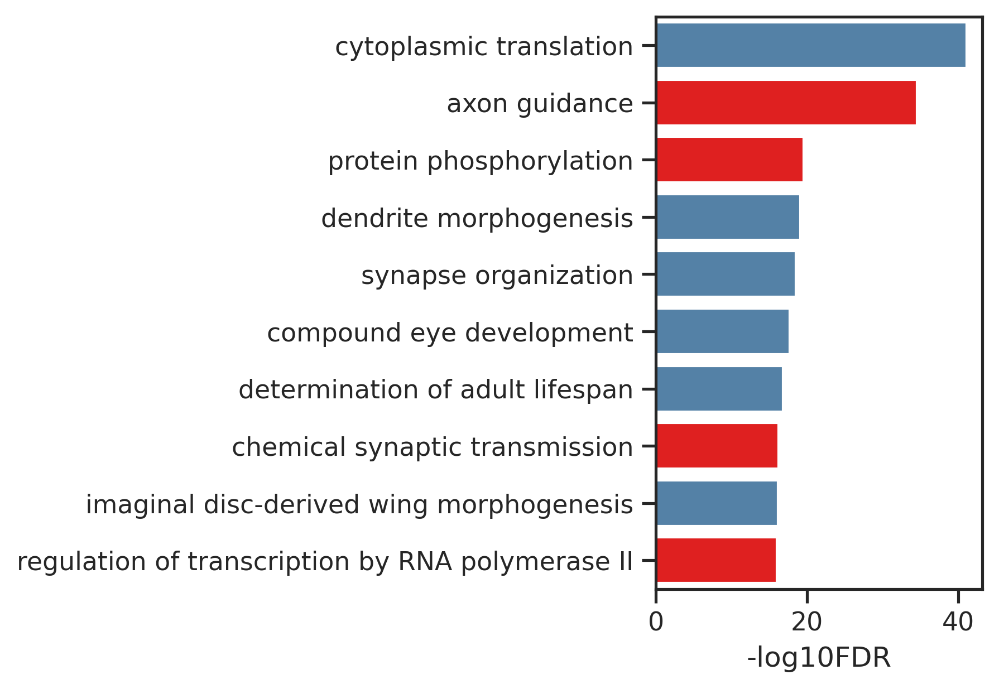

In [200]:
fig, ax = plt.subplots(figsize=(2.5, 4.5))
sns.barplot(data=tauGO_Df_top10.iloc[:10,:], x = '-log10FDR', y = 'name', ax=ax, width=0.8,
            palette=['red' if name in overlapGO_L else 'steelblue' for name in tauGO_Df_top10.name])
plt.ylabel('')
# plt.savefig(f'{figure2PicFolder}/barplot_GO_ABeta42-specificCluster.pdf', bbox_inches='tight')

plt.show()

## GOs from ADFCA VNC

In [224]:
tauAdfcaGO_Df = pd.read_csv(f'/data/tcl/Project/ADFCA/Analysis/Figure/Figure3/GO_compareToControl/geneName/adult ventral nervous system_all_hTau_symbols.tsv', sep='\t')
tauAdfcaGO_Df['group'] = 'hTau'
tauAdfcaGO_Df['-log10FDR'] = -np.log10(tauAdfcaGO_Df.p_fdr_bh)
tauAdfcaGO_Df = tauAdfcaGO_Df[tauAdfcaGO_Df.enrichment == 'e']
tauAdfcaGO_Df_top10 =tauAdfcaGO_Df.iloc[:10,:]
tauAdfcaGO_Df_top10

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
0,GO:1902600,BP,e,proton transmembrane transport,15/433,50/17562,6.082090e-13,8,15,3.144440e-09,"ATP6AP2, ATPsynC, ATPsynCF6, ATPsynD, ATPsynF,...",hTau,8.502457
1,GO:0098609,BP,e,cell-cell adhesion,11/433,45/17562,8.606089e-09,3,11,2.016224e-05,"CadN, Fas3, Zyx, alpha-Cat, bves, ds, ed, fred...",hTau,4.695461
2,GO:0015986,BP,e,proton motive force-driven ATP synthesis,8/433,20/17562,1.243901e-08,12,8,2.016224e-05,"ATPsynC, ATPsynCF6, ATPsynD, ATPsynG, ATPsynga...",hTau,4.695461
3,GO:0006122,BP,e,"mitochondrial electron transport, ubiquinol to...",7/433,14/17562,1.559941e-08,8,7,2.016224e-05,"Cyt-c-p, Cyt-c1, RFeSP, UQCR-14, UQCR-C2, UQCR...",hTau,4.695461
4,GO:0006123,BP,e,"mitochondrial electron transport, cytochrome c...",8/433,21/17562,1.966254e-08,8,8,2.033106e-05,"COX4, COX5A, COX7A, COX7C, Cyt-c-p, cype, mt:C...",hTau,4.691840
5,GO:0000381,BP,e,"regulation of alternative mRNA splicing, via s...",14/433,87/17562,2.611105e-08,10,14,2.249902e-05,"B52, CG11360, Doa, Rbfox1, Rbp1, Rbp1-like, Rm...",hTau,4.647836
6,GO:0007268,BP,e,chemical synaptic transmission,14/433,94/17562,7.190677e-08,7,14,5.172002e-05,"Acsl, CaMKII, Pgk, Shab, cac, cpo, dnc, nAChRa...",hTau,4.286341
7,GO:0006468,BP,e,protein phosphorylation,20/433,195/17562,8.003097e-08,6,20,5.172002e-05,"Alk, CG17698, CG31145, CG34357, CaMKI, CaMKII,...",hTau,4.286341
8,GO:0008039,BP,e,synaptic target recognition,9/433,34/17562,9.405948e-08,4,9,5.403195e-05,"CG32373, Fas3, Fur1, Sema1a, Ten-a, Ten-m, hig...",hTau,4.267349
9,GO:0045467,BP,e,R7 cell development,6/433,15/17562,8.993629e-07,8,6,4.649706e-04,"CadN, CadN2, RhoGAP100F, Ten-m, lola, tutl",hTau,3.332574


In [228]:
tauAdfcaGO_Df.head(50)

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
0,GO:1902600,BP,e,proton transmembrane transport,15/433,50/17562,6.082090e-13,8,15,3.144440e-09,"ATP6AP2, ATPsynC, ATPsynCF6, ATPsynD, ATPsynF,...",hTau,8.502457
1,GO:0098609,BP,e,cell-cell adhesion,11/433,45/17562,8.606089e-09,3,11,2.016224e-05,"CadN, Fas3, Zyx, alpha-Cat, bves, ds, ed, fred...",hTau,4.695461
2,GO:0015986,BP,e,proton motive force-driven ATP synthesis,8/433,20/17562,1.243901e-08,12,8,2.016224e-05,"ATPsynC, ATPsynCF6, ATPsynD, ATPsynG, ATPsynga...",hTau,4.695461
3,GO:0006122,BP,e,"mitochondrial electron transport, ubiquinol to...",7/433,14/17562,1.559941e-08,8,7,2.016224e-05,"Cyt-c-p, Cyt-c1, RFeSP, UQCR-14, UQCR-C2, UQCR...",hTau,4.695461
4,GO:0006123,BP,e,"mitochondrial electron transport, cytochrome c...",8/433,21/17562,1.966254e-08,8,8,2.033106e-05,"COX4, COX5A, COX7A, COX7C, Cyt-c-p, cype, mt:C...",hTau,4.691840
5,GO:0000381,BP,e,"regulation of alternative mRNA splicing, via s...",14/433,87/17562,2.611105e-08,10,14,2.249902e-05,"B52, CG11360, Doa, Rbfox1, Rbp1, Rbp1-like, Rm...",hTau,4.647836
6,GO:0007268,BP,e,chemical synaptic transmission,14/433,94/17562,7.190677e-08,7,14,5.172002e-05,"Acsl, CaMKII, Pgk, Shab, cac, cpo, dnc, nAChRa...",hTau,4.286341
7,GO:0006468,BP,e,protein phosphorylation,20/433,195/17562,8.003097e-08,6,20,5.172002e-05,"Alk, CG17698, CG31145, CG34357, CaMKI, CaMKII,...",hTau,4.286341
8,GO:0008039,BP,e,synaptic target recognition,9/433,34/17562,9.405948e-08,4,9,5.403195e-05,"CG32373, Fas3, Fur1, Sema1a, Ten-a, Ten-m, hig...",hTau,4.267349
9,GO:0045467,BP,e,R7 cell development,6/433,15/17562,8.993629e-07,8,6,4.649706e-04,"CadN, CadN2, RhoGAP100F, Ten-m, lola, tutl",hTau,3.332574


In [ ]:
proton_L = tauAdfcaGO_Df.iloc[0, -3]
proton_L

'ATP6AP2, ATPsynC, ATPsynCF6, ATPsynD, ATPsynF, ATPsynG, OtopLa, Vha13, Vha14-1, Vha16-1, Vha26, Vha36-1, VhaM9.7-a, blw, sun'

In [ ]:
translation_L = tauAdfcaGO_Df.iloc[40, -3]
translation_L

'RpL3, RpL37a, RpL5, RpL7, RpL8, RpS15Aa, RpS2, RpS4, RpS6, sta'

In [192]:
tauAdfcaGO_Df = pd.read_csv(f"{degGenoControlBroadNeuFolder}/GO_panNeuron_degTau_symbols.tsv", sep='\t')
tauAdfcaGO_Df['group'] = 'hTau'
tauAdfcaGO_Df['-log10FDR'] = -np.log10(tauAdfcaGO_Df.p_fdr_bh)
tauAdfcaGO_Df = tauAdfcaGO_Df[tauAdfcaGO_Df.enrichment == 'e']
tauAdfcaGO_Df_top10 =tauAdfcaGO_Df.iloc[:10,:]

In [193]:
overlapGO_L = list(set(tauGO_Df_top10.name) & set(tauAdfcaGO_Df_top10.name))
overlapGO_L

['axon guidance',
 'protein phosphorylation',
 'chemical synaptic transmission',
 'regulation of transcription by RNA polymerase II']

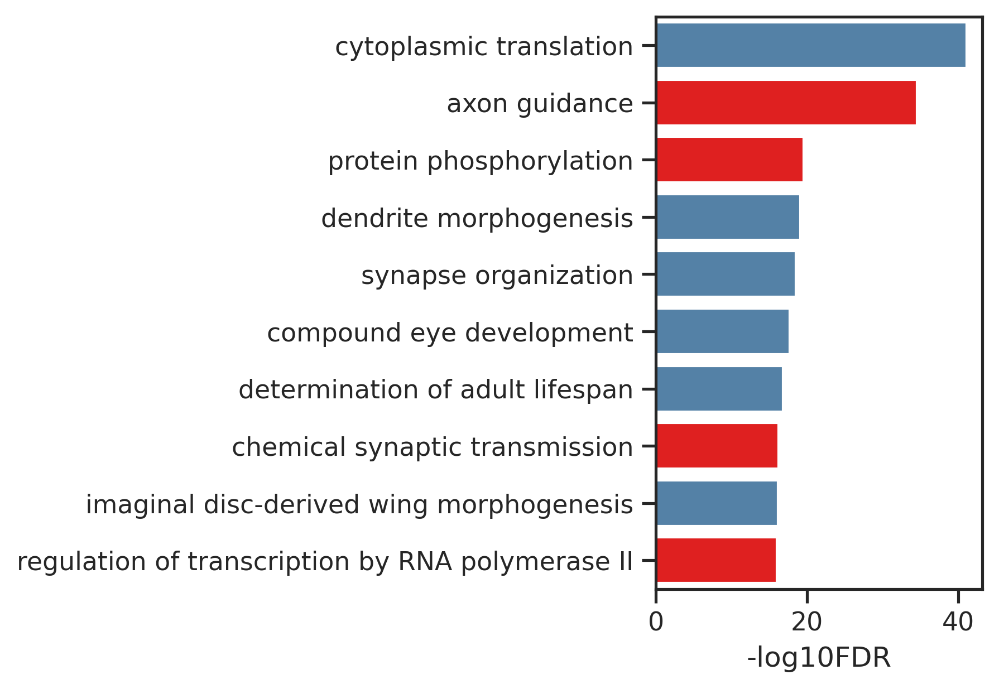

In [292]:
fig, ax = plt.subplots(figsize=(2.5, 4.5))
sns.barplot(data=tauGO_Df_top10.iloc[:10,:], x = '-log10FDR', y = 'name', ax=ax, width=0.8,
            palette=['red' if name in overlapGO_L else 'steelblue' for name in tauGO_Df_top10.name])
plt.ylabel('')
plt.savefig(f'{Neuron2023PicFolder}/barplot_GO_ABeta42-specificCluster.pdf', bbox_inches='tight')

plt.show()

# Compare DEGs: ADFCA VNC vs. Neuron2023 TauP301L neurons

## Load DEGs

In [201]:
deg_Neuron2023_Df = pd.read_csv('/data/tcl/Project/ADFCA/Analysis/Figure_2023NeuronTau/degFolder/panNeuron_tau_vs_mini.csv')
deg_Neuron2023_Df

,P301L_names,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges
0,tau[P301L],0.0,0.0,12.510933
1,Ank2,0.0,0.0,0.680792
2,lncRNA:alphagamma-element:CR32865,0.0,0.0,4.074444
3,kis,0.0,0.0,0.740566
4,unc-13,0.0,0.0,0.428607
...,...,...,...,...
17612,RpL38,0.0,0.0,-0.444091
17613,RpL21,0.0,0.0,-0.422296
17614,RpL37a,0.0,0.0,-0.431880
17615,RpS18,0.0,0.0,-0.458340


In [203]:
deg_adfcaVNC_Df = pd.read_csv('/data/tcl/Project/ADFCA/Analysis/Figure/Figure3/DEG_genotype_toControl/adult ventral nervous system_hTau_control_inTau.csv')
deg_adfcaVNC_Df_e5 = deg_adfcaVNC_Df[deg_adfcaVNC_Df.hTau_pvals_adj < 0.05]
deg_adfcaVNC_Df_e5.reset_index(drop=True, inplace=True)
deg_adfcaVNC_Df_e5

,hTau_names,hTau_pvals,hTau_pvals_adj,hTau_logfoldchanges
0,hTau0N4Rfull,0.000000e+00,0.000000e+00,31.640362
1,Parp,3.091841e-94,1.671552e-90,0.979855
2,Cadps,1.037632e-69,4.207339e-66,0.629717
3,CG17684,1.334493e-47,4.328830e-44,0.344661
4,pan,6.661949e-40,1.543574e-36,0.517815
...,...,...,...,...
429,pAbp,1.371567e-33,1.483029e-30,-2.398694
430,COX4,1.361310e-33,1.483029e-30,-3.047157
431,lncRNA:roX1,5.615850e-34,7.590290e-31,-1.185884
432,sesB,1.161025e-44,3.138444e-41,-1.742938


In [204]:
overlapGene_L = list(set(deg_adfcaVNC_Df_e5.hTau_names) & set(deg_Neuron2023_Df.P301L_names))
len(overlapGene_L)

432

In [208]:
deg_Neuron2023_Df_vncDegs.columns

Index(['P301L_names', 'P301L_pvals', 'P301L_pvals_adj',
       'P301L_logfoldchanges'],
      dtype='object')

In [210]:
deg_Neuron2023_Df_vncDegs = deg_Neuron2023_Df[deg_Neuron2023_Df.P301L_names.isin(overlapGene_L)]
deg_Neuron2023_Df_vncDegs.columns = ['names'] + deg_Neuron2023_Df_vncDegs.columns.to_list()[1:]
deg_Neuron2023_Df_vncDegs.index = deg_Neuron2023_Df_vncDegs.names.to_list()

deg_adfcaVNC_Df_e5_overlap = deg_adfcaVNC_Df_e5[deg_adfcaVNC_Df_e5.hTau_names.isin(overlapGene_L)]
deg_adfcaVNC_Df_e5_overlap.columns = ['names'] + deg_adfcaVNC_Df_e5_overlap.columns.to_list()[1:]
deg_adfcaVNC_Df_e5_overlap.index = deg_adfcaVNC_Df_e5_overlap.names.to_list()

deg_Neuron2023_Df_vncDegs

,names,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges
kis,kis,0.0,0.0,0.740566
unc-13,unc-13,0.0,0.0,0.428607
mtd,mtd,0.0,0.0,0.607117
mub,mub,0.0,0.0,0.594857
sif,sif,0.0,0.0,0.576714
...,...,...,...,...
aqz,aqz,0.0,0.0,-0.204646
RpL7,RpL7,0.0,0.0,-0.398458
sta,sta,0.0,0.0,-0.387242
RpL37a,RpL37a,0.0,0.0,-0.431880


In [211]:
mergeDf = pd.merge(deg_adfcaVNC_Df_e5_overlap, deg_Neuron2023_Df_vncDegs, on='names')
mergeDf

,names,hTau_pvals,hTau_pvals_adj,hTau_logfoldchanges,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges
0,Parp,3.091841e-94,1.671552e-90,0.979855,5.182475e-50,1.404610e-48,0.230204
1,Cadps,1.037632e-69,4.207339e-66,0.629717,0.000000e+00,0.000000e+00,0.443649
2,CG17684,1.334493e-47,4.328830e-44,0.344661,3.551248e-64,1.221921e-62,0.276396
3,pan,6.661949e-40,1.543574e-36,0.517815,9.106386e-297,1.823036e-294,0.350608
4,Nipped-A,1.007176e-38,2.041923e-35,0.825841,1.119499e-309,2.561326e-307,0.554082
...,...,...,...,...,...,...,...
427,pAbp,1.371567e-33,1.483029e-30,-2.398694,1.259272e-55,3.805248e-54,-0.083418
428,COX4,1.361310e-33,1.483029e-30,-3.047157,3.850211e-247,5.898189e-245,-0.379668
429,lncRNA:roX1,5.615850e-34,7.590290e-31,-1.185884,2.839140e-32,5.322384e-31,0.070441
430,sesB,1.161025e-44,3.138444e-41,-1.742938,1.117055e-30,2.026691e-29,-0.091018


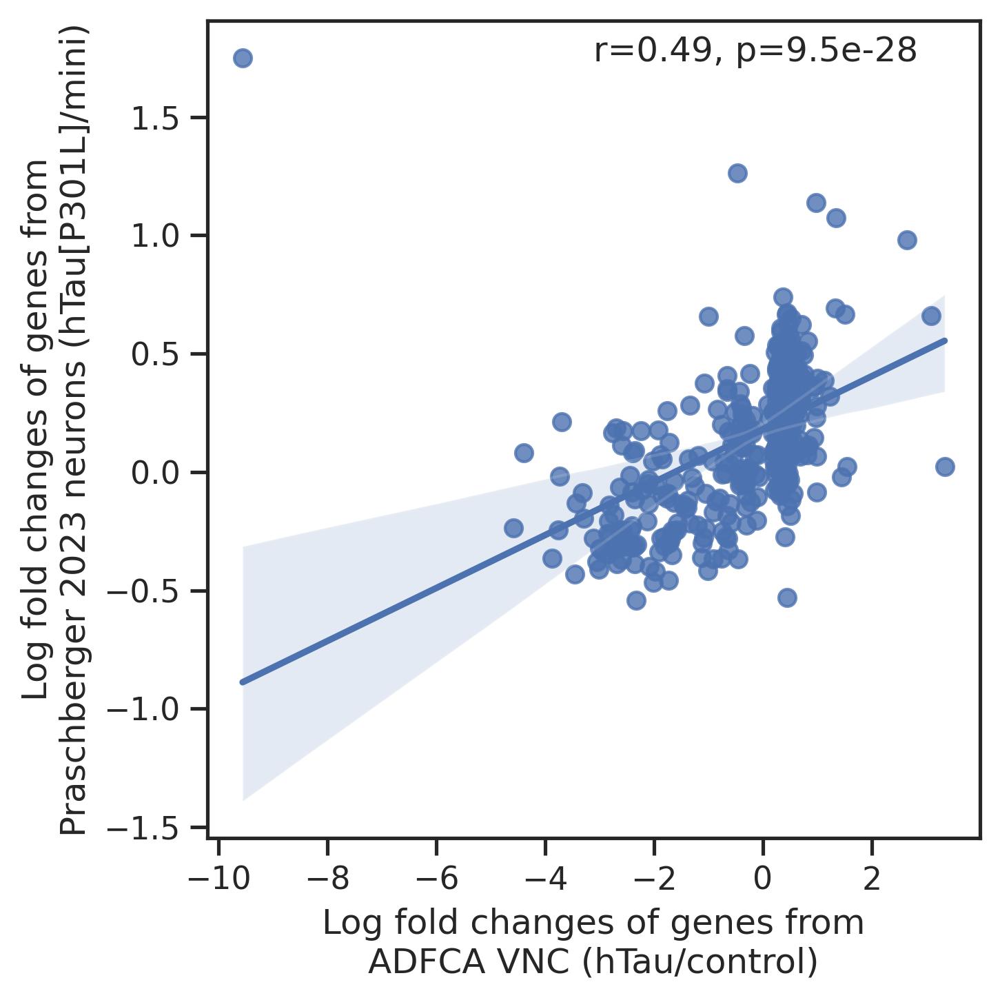

In [232]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_logfoldchanges", y="P301L_logfoldchanges", data=mergeDf)
    r, p = stats.pearsonr(mergeDf["hTau_logfoldchanges"], mergeDf['P301L_logfoldchanges'])

    g.text(.50, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    plt.xlabel('Log fold changes of genes from\nADFCA VNC (hTau/control)')
    plt.ylabel('Log fold changes of genes from\nPraschberger 2023 neurons (hTau[P301L]/mini)')

    plt.tight_layout()
    # plt.savefig(f'{figure6PicFolder}/regression_umiN_mtx_body_correlation_noLabel.pdf', bbox_inches='tight')

In [246]:
tauAdfcaGO_Df.head(50)

,# GO,NS,enrichment,name,ratio_in_study,ratio_in_pop,p_uncorrected,depth,study_count,p_fdr_bh,study_items,group,-log10FDR
0,GO:1902600,BP,e,proton transmembrane transport,15/433,50/17562,6.082090e-13,8,15,3.144440e-09,"ATP6AP2, ATPsynC, ATPsynCF6, ATPsynD, ATPsynF,...",hTau,8.502457
1,GO:0098609,BP,e,cell-cell adhesion,11/433,45/17562,8.606089e-09,3,11,2.016224e-05,"CadN, Fas3, Zyx, alpha-Cat, bves, ds, ed, fred...",hTau,4.695461
2,GO:0015986,BP,e,proton motive force-driven ATP synthesis,8/433,20/17562,1.243901e-08,12,8,2.016224e-05,"ATPsynC, ATPsynCF6, ATPsynD, ATPsynG, ATPsynga...",hTau,4.695461
3,GO:0006122,BP,e,"mitochondrial electron transport, ubiquinol to...",7/433,14/17562,1.559941e-08,8,7,2.016224e-05,"Cyt-c-p, Cyt-c1, RFeSP, UQCR-14, UQCR-C2, UQCR...",hTau,4.695461
4,GO:0006123,BP,e,"mitochondrial electron transport, cytochrome c...",8/433,21/17562,1.966254e-08,8,8,2.033106e-05,"COX4, COX5A, COX7A, COX7C, Cyt-c-p, cype, mt:C...",hTau,4.691840
5,GO:0000381,BP,e,"regulation of alternative mRNA splicing, via s...",14/433,87/17562,2.611105e-08,10,14,2.249902e-05,"B52, CG11360, Doa, Rbfox1, Rbp1, Rbp1-like, Rm...",hTau,4.647836
6,GO:0007268,BP,e,chemical synaptic transmission,14/433,94/17562,7.190677e-08,7,14,5.172002e-05,"Acsl, CaMKII, Pgk, Shab, cac, cpo, dnc, nAChRa...",hTau,4.286341
7,GO:0006468,BP,e,protein phosphorylation,20/433,195/17562,8.003097e-08,6,20,5.172002e-05,"Alk, CG17698, CG31145, CG34357, CaMKI, CaMKII,...",hTau,4.286341
8,GO:0008039,BP,e,synaptic target recognition,9/433,34/17562,9.405948e-08,4,9,5.403195e-05,"CG32373, Fas3, Fur1, Sema1a, Ten-a, Ten-m, hig...",hTau,4.267349
9,GO:0045467,BP,e,R7 cell development,6/433,15/17562,8.993629e-07,8,6,4.649706e-04,"CadN, CadN2, RhoGAP100F, Ten-m, lola, tutl",hTau,3.332574


In [266]:
proton_L = tauAdfcaGO_Df.iloc[0, -3].split(', ')
proton_L

['ATP6AP2',
 'ATPsynC',
 'ATPsynCF6',
 'ATPsynD',
 'ATPsynF',
 'ATPsynG',
 'OtopLa',
 'Vha13',
 'Vha14-1',
 'Vha16-1',
 'Vha26',
 'Vha36-1',
 'VhaM9.7-a',
 'blw',
 'sun']

In [267]:
splicing_L = tauAdfcaGO_Df.iloc[5, -3].split(', ')
splicing_L

['B52',
 'CG11360',
 'Doa',
 'Rbfox1',
 'Rbp1',
 'Rbp1-like',
 'Rm62',
 'Saf-B',
 'Sxl',
 'bru3',
 'eIF4A',
 'mub',
 'ps',
 'sqd']

In [252]:
mito_L = tauAdfcaGO_Df.iloc[4, -3]
mito_L

'COX4, COX5A, COX7A, COX7C, Cyt-c-p, cype, mt:CoI, mt:CoII'

In [268]:
phospho_L = tauAdfcaGO_Df.iloc[7, -3].split(', ')
phospho_L

['Alk',
 'CG17698',
 'CG31145',
 'CG34357',
 'CaMKI',
 'CaMKII',
 'Cam',
 'Ddr',
 'Doa',
 'Dyrk2',
 'Gprk1',
 'Haspin',
 'Lk6',
 'Stlk',
 'aPKC',
 'cdi',
 'gish',
 'msn',
 'rl',
 'tkv']

In [269]:
translation_L = tauAdfcaGO_Df.iloc[40, -3].split(', ')
translation_L

['RpL3',
 'RpL37a',
 'RpL5',
 'RpL7',
 'RpL8',
 'RpS15Aa',
 'RpS2',
 'RpS4',
 'RpS6',
 'sta']

In [276]:
selectedTerm_L = tauAdfcaGO_Df.iloc[[0, 4, 40], 3].to_list()
selectedTerm_L

['proton transmembrane transport',
 'mitochondrial electron transport, cytochrome c to oxygen',
 'cytoplasmic translation']

In [279]:
gene2Term_D = {}
for term in selectedTerm_L:
    termGene_L = tauAdfcaGO_Df[ tauAdfcaGO_Df.name == term ].iloc[0, -3].split(', ')
    print(term, termGene_L)
    
    for gene in termGene_L:
        if gene not in gene2Term_D.keys(): gene2Term_D[gene] = term
        else: print(gene)

proton transmembrane transport ['ATP6AP2', 'ATPsynC', 'ATPsynCF6', 'ATPsynD', 'ATPsynF', 'ATPsynG', 'OtopLa', 'Vha13', 'Vha14-1', 'Vha16-1', 'Vha26', 'Vha36-1', 'VhaM9.7-a', 'blw', 'sun']
mitochondrial electron transport, cytochrome c to oxygen ['COX4', 'COX5A', 'COX7A', 'COX7C', 'Cyt-c-p', 'cype', 'mt:CoI', 'mt:CoII']
cytoplasmic translation ['RpL3', 'RpL37a', 'RpL5', 'RpL7', 'RpL8', 'RpS15Aa', 'RpS2', 'RpS4', 'RpS6', 'sta']


In [280]:
gene2Term_D

{'ATP6AP2': 'proton transmembrane transport',
 'ATPsynC': 'proton transmembrane transport',
 'ATPsynCF6': 'proton transmembrane transport',
 'ATPsynD': 'proton transmembrane transport',
 'ATPsynF': 'proton transmembrane transport',
 'ATPsynG': 'proton transmembrane transport',
 'OtopLa': 'proton transmembrane transport',
 'Vha13': 'proton transmembrane transport',
 'Vha14-1': 'proton transmembrane transport',
 'Vha16-1': 'proton transmembrane transport',
 'Vha26': 'proton transmembrane transport',
 'Vha36-1': 'proton transmembrane transport',
 'VhaM9.7-a': 'proton transmembrane transport',
 'blw': 'proton transmembrane transport',
 'sun': 'proton transmembrane transport',
 'COX4': 'mitochondrial electron transport, cytochrome c to oxygen',
 'COX5A': 'mitochondrial electron transport, cytochrome c to oxygen',
 'COX7A': 'mitochondrial electron transport, cytochrome c to oxygen',
 'COX7C': 'mitochondrial electron transport, cytochrome c to oxygen',
 'Cyt-c-p': 'mitochondrial electron tran

In [286]:
mergeDf['group'] = pd.Categorical([gene2Term_D[gene] if gene in gene2Term_D.keys() else 'others' for gene in mergeDf.names], 
                                  categories=['cytoplasmic translation', 'mitochondrial electron transport, cytochrome c to oxygen','proton transmembrane transport', 'others'])

mergeDf

,names,hTau_pvals,hTau_pvals_adj,hTau_logfoldchanges,P301L_pvals,P301L_pvals_adj,P301L_logfoldchanges,group
0,Parp,3.091841e-94,1.671552e-90,0.979855,5.182475e-50,1.404610e-48,0.230204,others
1,Cadps,1.037632e-69,4.207339e-66,0.629717,0.000000e+00,0.000000e+00,0.443649,others
2,CG17684,1.334493e-47,4.328830e-44,0.344661,3.551248e-64,1.221921e-62,0.276396,others
3,pan,6.661949e-40,1.543574e-36,0.517815,9.106386e-297,1.823036e-294,0.350608,others
4,Nipped-A,1.007176e-38,2.041923e-35,0.825841,1.119499e-309,2.561326e-307,0.554082,others
...,...,...,...,...,...,...,...,...
427,pAbp,1.371567e-33,1.483029e-30,-2.398694,1.259272e-55,3.805248e-54,-0.083418,others
428,COX4,1.361310e-33,1.483029e-30,-3.047157,3.850211e-247,5.898189e-245,-0.379668,"mitochondrial electron transport, cytochrome c..."
429,lncRNA:roX1,5.615850e-34,7.590290e-31,-1.185884,2.839140e-32,5.322384e-31,0.070441,others
430,sesB,1.161025e-44,3.138444e-41,-1.742938,1.117055e-30,2.026691e-29,-0.091018,others


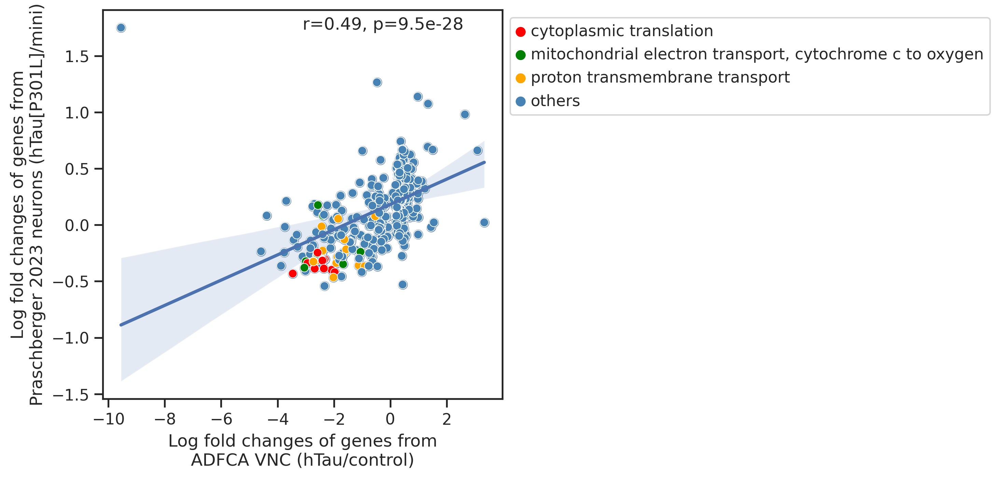

In [301]:
with rc_context({'figure.figsize': (5, 5)}):
    fig, ax = plt.subplots(figsize = (5,5) )
    sns.regplot(x="hTau_logfoldchanges", y="P301L_logfoldchanges", data=mergeDf, ax=ax)
    sns.scatterplot(x="hTau_logfoldchanges", y="P301L_logfoldchanges", data=mergeDf, hue='group', palette=['red', 'green', 'orange', 'steelblue'], ax=ax) # alpha=0.5,
                    # palette=['red' if gene in translation_L else 'orange' if gene in proton_L else 'black' if gene in mito_L else 'steelblue' for gene in mergeDf.names])
    r, p = stats.pearsonr(mergeDf["hTau_logfoldchanges"], mergeDf['P301L_logfoldchanges'])

    # g.text(.50, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  
    ax.text(.50, .95, f'r={r:.2f}, p={p:.2g}', transform=ax.transAxes) # 

    # ax.xlabel('Log fold changes of genes from\nADFCA VNC (hTau/control)')
    # ax.ylabel('Log fold changes of genes from\nPraschberger 2023 neurons (hTau[P301L]/mini)')
    ax.set(xlabel='Log fold changes of genes from\nADFCA VNC (hTau/control)', 
           ylabel='Log fold changes of genes from\nPraschberger 2023 neurons (hTau[P301L]/mini)')
    
    ax.legend(bbox_to_anchor=(1.00, 1.00))
    plt.savefig(f'{Neuron2023PicFolder}/regression_adfca-VNC-DEGs__logFC_inNeuron2023.pdf', bbox_inches='tight')
    plt.show()
    # g.savefig(f'{Neuron2023PicFolder}/regression_adfca-VNC-DEGs__logFC_inNeuron2023.pdf', bbox_inches='tight')

# Finish